#### Notebook config

In [18]:
# %load /home/kmc3817/software/fullwavepy/fullwavepy/config/jupyter.py 
from fullwavepy import * # Load modules imported in fullwavepy/__init__.py
from arrau import *
# -----------------------------------------------------------------------------
# Set aliases of frequently used jupyter magic commands
# -----------------------------------------------------------------------------
%alias_magic mi matplotlib -p inline
%alias_magic mn matplotlib -p notebook
# -----------------------------------------------------------------------------
# Set matplotlib backend
# -----------------------------------------------------------------------------
# non-interactive plots displayed in a notebook cell
%matplotlib inline
# interactive plots displayed in a notebook cell
# %matplotlib notebook (interactive version)
# -----------------------------------------------------------------------------
# Set matplotlib style
# ----------------------------------------------------------------------------
plt.style.reload_library()
# a combined style (right overwrites left wherever they overlap):
plt.style.use(['default', 'ggplot'])
# print(plt.style.available) 
# -----------------------------------------------------------------------------
# Configure logging
# -----------------------------------------------------------------------------
# Set up loggers, handlers and load the log_lvl function
from fullwavepy.config.logging import *
# -----------------------------------------------------------------------------
# Set level of log-messages
log_lvl(ERROR) 
# Other options in order of increasing importance and 
# decreasing verbosity:
# TRACE, DEBUG, INFO, WARNING, ERROR, CRITICAL
# or using integers: 0, 10, 20, 30, 40, 50, respectively
# -----------------------------------------------------------------------------
# Autocompleting
# -----------------------------------------------------------------------------
#  Not sure if it works
#%config IPCompleter.greedy=True 
# -----------------------------------------------------------------------------
# Automatically reload modules before execution
#%load_ext autoreload
#%autoreload 2

Created `%mi` as an alias for `%matplotlib inline`.
Created `%mn` as an alias for `%matplotlib notebook`.


##### Init synthetic project (see `0831...ipynb`)

In [19]:
# some vars 
from arrau import *
from fullwavepy.seismic.proteus import PROTEUS
path_eph = '/home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch08_Kolumbo_volcano'
exe = { 
    'fullwave':  '~/PhD/fullwave3D/rev690/bin/fullwave3D.exe',
    'fullwave_local': '/home/kmc3817/light_PhD/fullwave3D/rev690/bin/fullwave3D.exe',
    'segyprep':  '/home/kmc3817/light_PhD/fullwave3D/segyprep_v3.16/bin/segyprep_v3.16'} 
xp = PROTEUS()
b01 = xp.box['kol1']
lll(40)

In [20]:
dis01 = {'dt': 0.0025, 'dx': 50, 'ns': 3000} 
s01 = ProjSyn('method_s01', path = './', exe=exe, box=b01.box, **dis01, cat=0)

# Init workflow

#### Def.
Ensemble of anomalies.

In [21]:
from fullwavepy.fwi.project import ProjEnsemble
class Anom:
    pass
class AnomShape:
    pass
class Spike(Anom):
    def create(self, xyz, fwhm, ampl, unit='fraction'):
        self.x, self.y, self.z = xyz
        self.xyz = xyz
        self.fwhm = fwhm
        self.ampl = ampl
        self.unit = unit
class SpikeEnsemble(ProjEnsemble):
    def __init__(self, *args, **kwargs):
        self.ampl = {}
        self.fwhm = {}
        self.flow = {}
        self.syn = {}
        self.inv = {}
        self.kwargs = kwargs
        super().__init__(*args, **kwargs)
    def add(self, ampl, fwhm, flow, **kwargs):
        self.ampl[flow.name] = ampl
        self.fwhm[flow.name] = fwhm
        self.flow[flow.name] = flow
        # these are handles to fullwavepy (not fwilight) projects
        self.syn[flow.name] = ProjSyn(flow.syn.name, path=flow.path, 
                                      **dict(kwargs, cat=0))
        self.inv[flow.name] = ProjInv(flow.inv.name, path=flow.path, 
                                      **dict(kwargs, cat=0))

In [ ]:
#         def init(self, fwhm_ampl_pairs, **kwargs):
#             for fwhm, ampl in fwhm_ampl_pairs:
#                 name = 'fwhm%s_ampl%s' % (str(fwhm).rjust(4,'0'), str(int((round(ampl,2)) * (-100))).rjust(3,'0'))
#                 name = '%s_%s' % (self.name, name)            
#                 self.fwhm[name] = fwhm
#                 self.ampl[name] = ampl
#                 self.syn[name] = ProjSyn(name+'_syn', path=self.path, 
#                                               **dict(kwargs, cat=0))
#                 self.inv[name] = ProjInv(name+'_inv', path=self.path, 
#                                               **dict(kwargs, cat=0))

#### Alg.
Init ensemble of workflows. First, prepare parameters of anomalies:

In [22]:
fwhm_ampl_pairs = []
for fwhm in [200, 800, 1400]:
    for ampl in [-0.5, -0.1, -0.05, -0.01]:
        if fwhm == 200 and ampl > -0.1:
            continue
        fwhm_ampl_pairs.append([fwhm, ampl])

Then, init ensemble of workflows:

In [23]:
%%time 
from fwilight.fwi import FlowInvObsChq 
# from fullwavepy.fwi.workflows import InvertFieldCheq # fixme
path = './'
en = SpikeEnsemble('spike', path)
kws = dict(dt=0.0025, ns=3000, # later change for inversion!!!
           dx=50, box=b01.box, exp='proteus',
           env={'SLAVES_WAVEFIELDSVTR':-100}, exe=exe,
           precode='sp-316', fwicode='fw3d-690', ibmcode=None)
for fwhm, ampl in fwhm_ampl_pairs:
    name = 'fwhm%s_ampl%s' % (str(fwhm).rjust(4,'0'), str(int((round(ampl,2)) * (-100))).rjust(3,'0'))
    name = '%s_%s' % (en.name, name)
    f = FlowInvObsChq(name, path)
    f.run([0], **kws)
    en.add(ampl, fwhm, f, **kws)

Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
CPU times: user 9.13 s, sys: 1.44 s, total: 10.6 s
Wall time: 12.4 s


In [27]:
en.syn

{'spike_fwhm0200_ampl010': <fullwavepy.project.types.basic.ProjSyn at 0x7f333dc03e48>,
 'spike_fwhm0200_ampl050': <fullwavepy.project.types.basic.ProjSyn at 0x7f356c2d42e8>,
 'spike_fwhm0800_ampl001': <fullwavepy.project.types.basic.ProjSyn at 0x7f338d89c3c8>,
 'spike_fwhm0800_ampl005': <fullwavepy.project.types.basic.ProjSyn at 0x7f392599d9b0>,
 'spike_fwhm0800_ampl010': <fullwavepy.project.types.basic.ProjSyn at 0x7f338d859f98>,
 'spike_fwhm0800_ampl050': <fullwavepy.project.types.basic.ProjSyn at 0x7f398fcd1828>,
 'spike_fwhm1400_ampl001': <fullwavepy.project.types.basic.ProjSyn at 0x7f398fc22358>,
 'spike_fwhm1400_ampl005': <fullwavepy.project.types.basic.ProjSyn at 0x7f398feca940>,
 'spike_fwhm1400_ampl010': <fullwavepy.project.types.basic.ProjSyn at 0x7f394dd4b7b8>,
 'spike_fwhm1400_ampl050': <fullwavepy.project.types.basic.ProjSyn at 0x7f395c50eda0>}

#### Alg.
Another version. NOT used for now.

In [24]:
fwhm_ampl_pairs = []
for fwhm in [200, 800, 1400]:
    for ampl in [-0.5, -0.1, -0.05, -0.01]:
        if fwhm == 200 and ampl > -0.1:
            continue
        fwhm_ampl_pairs.append([fwhm, ampl])

Then, init ensemble of workflows:

In [11]:
path = './'
en = SpikeEnsemble('gauss', path)
env = {'SLAVES_WAVEFIELDSVTR':-100}
kwargs = dict(dt=0.0025, ns=2500, dx=50, box=b01.box, exp='proteus', env=env, exe=exe)
for fwhm, ampl in fwhm_ampl_pairs:
    name = 'fwhm%s_ampl%s' % (str(fwhm).rjust(4,'0'), str(int((round(ampl,2)) * (-100))).rjust(3,'0'))
    name = '%s_%s' % (en.name, name)            
    en.fwhm[name] = fwhm
    en.ampl[name] = ampl
    en.syn[name] = ProjSyn(name+'_syn', path=path, 
                                  **dict(kwargs, cat=0))
    en.inv[name] = ProjInv(name+'_inv', path=path, 
                                  **dict(kwargs, cat=0))
    break

# Calculate synthetics

## Inp

### Prep

In [25]:
x0, y0, z0 = 13250, 8750, 2750
kw_chqr = dict(anom='spike', x0=x0, y0=y0, z0=z0)

In [50]:
%%time 
# took 20 min. without syncing
kws = dict(data_fname='../../data/p14-Observed.sgy', cat=0,
            ztype='d', addtodepth=0, reciprocity=1, b_abs=40, e_abs=50)
for name, f in sorted(en.flow.items()):
    ampl = en.ampl[name]
    fwhm = en.fwhm[name]
    kw_chqr = dict(kw_chqr, ampl=ampl, fwhm=fwhm)
#     f.run([1], **kws, kw_chqr=kw_chqr) # prepares pbs.no[0] for debug
    f.syn.i.rnf.prep(b_abs=40, e_abs=50)
    f.syn.i.pbs.no[1].prep(select=4, q='pqmrwarn')
    f.syn.i.rsync('my_eph')    

Content of  .//spike_fwhm0200_ampl010syn//inp/spike_fwhm0200_ampl010syn-Runfile.key : 

    ! May 2019, K. Chrapkiewicz 
    ! THIS RUNFILE CONFORMS TO
    ! FULLWAVE REV. 688 STANDARD
    
    
    ! A. PROBLEM DEFINITION
     problem       : synthetic
     domain        : time
     dim           : 3d
     equation      : acoustic
     units         : metric
     anisotropy    : none
     kernel        : low
    
     
    ! B. MODEL DEFINITION
     nx1           : 341
     nx2           : 361
     nx3           : 81
     dx            : 50.0000000
    
     
    ! C. DATA DEFINITION
     ncomp         : 16
     nshots        : 16
     nrecs         : 1481
     maxrc         : 1144
     maxps         : 1
     io            : segy
    
     
    ! D. BOUNDARY CONDITIONS
     ibfs          : 0
     multisurf     : 0
     nosprdfctrs   : 0     
     seaLevel      : 0
     maxGhostIter  : 2
     vacuum        : 0
     accuracy      : 0.001
     minGhostFS    : 0.001
     minFictFS     : 0

Content of  .//spike_fwhm0800_ampl001syn//inp/spike_fwhm0800_ampl001syn-Runfile.key : 

    ! May 2019, K. Chrapkiewicz 
    ! THIS RUNFILE CONFORMS TO
    ! FULLWAVE REV. 688 STANDARD
    
    
    ! A. PROBLEM DEFINITION
     problem       : synthetic
     domain        : time
     dim           : 3d
     equation      : acoustic
     units         : metric
     anisotropy    : none
     kernel        : low
    
     
    ! B. MODEL DEFINITION
     nx1           : 341
     nx2           : 361
     nx3           : 81
     dx            : 50.0000000
    
     
    ! C. DATA DEFINITION
     ncomp         : 16
     nshots        : 16
     nrecs         : 1481
     maxrc         : 1144
     maxps         : 1
     io            : segy
    
     
    ! D. BOUNDARY CONDITIONS
     ibfs          : 0
     multisurf     : 0
     nosprdfctrs   : 0     
     seaLevel      : 0
     maxGhostIter  : 2
     vacuum        : 0
     accuracy      : 0.001
     minGhostFS    : 0.001
     minFictFS     : 0

Content of  .//spike_fwhm0800_ampl010syn//inp/spike_fwhm0800_ampl010syn-Runfile.key : 

    ! May 2019, K. Chrapkiewicz 
    ! THIS RUNFILE CONFORMS TO
    ! FULLWAVE REV. 688 STANDARD
    
    
    ! A. PROBLEM DEFINITION
     problem       : synthetic
     domain        : time
     dim           : 3d
     equation      : acoustic
     units         : metric
     anisotropy    : none
     kernel        : low
    
     
    ! B. MODEL DEFINITION
     nx1           : 341
     nx2           : 361
     nx3           : 81
     dx            : 50.0000000
    
     
    ! C. DATA DEFINITION
     ncomp         : 16
     nshots        : 16
     nrecs         : 1481
     maxrc         : 1144
     maxps         : 1
     io            : segy
    
     
    ! D. BOUNDARY CONDITIONS
     ibfs          : 0
     multisurf     : 0
     nosprdfctrs   : 0     
     seaLevel      : 0
     maxGhostIter  : 2
     vacuum        : 0
     accuracy      : 0.001
     minGhostFS    : 0.001
     minFictFS     : 0

Content of  .//spike_fwhm1400_ampl001syn//inp/spike_fwhm1400_ampl001syn-Runfile.key : 

    ! May 2019, K. Chrapkiewicz 
    ! THIS RUNFILE CONFORMS TO
    ! FULLWAVE REV. 688 STANDARD
    
    
    ! A. PROBLEM DEFINITION
     problem       : synthetic
     domain        : time
     dim           : 3d
     equation      : acoustic
     units         : metric
     anisotropy    : none
     kernel        : low
    
     
    ! B. MODEL DEFINITION
     nx1           : 341
     nx2           : 361
     nx3           : 81
     dx            : 50.0000000
    
     
    ! C. DATA DEFINITION
     ncomp         : 16
     nshots        : 16
     nrecs         : 1481
     maxrc         : 1144
     maxps         : 1
     io            : segy
    
     
    ! D. BOUNDARY CONDITIONS
     ibfs          : 0
     multisurf     : 0
     nosprdfctrs   : 0     
     seaLevel      : 0
     maxGhostIter  : 2
     vacuum        : 0
     accuracy      : 0.001
     minGhostFS    : 0.001
     minFictFS     : 0

Content of  .//spike_fwhm1400_ampl010syn//inp/spike_fwhm1400_ampl010syn-Runfile.key : 

    ! May 2019, K. Chrapkiewicz 
    ! THIS RUNFILE CONFORMS TO
    ! FULLWAVE REV. 688 STANDARD
    
    
    ! A. PROBLEM DEFINITION
     problem       : synthetic
     domain        : time
     dim           : 3d
     equation      : acoustic
     units         : metric
     anisotropy    : none
     kernel        : low
    
     
    ! B. MODEL DEFINITION
     nx1           : 341
     nx2           : 361
     nx3           : 81
     dx            : 50.0000000
    
     
    ! C. DATA DEFINITION
     ncomp         : 16
     nshots        : 16
     nrecs         : 1481
     maxrc         : 1144
     maxps         : 1
     io            : segy
    
     
    ! D. BOUNDARY CONDITIONS
     ibfs          : 0
     multisurf     : 0
     nosprdfctrs   : 0     
     seaLevel      : 0
     maxGhostIter  : 2
     vacuum        : 0
     accuracy      : 0.001
     minGhostFS    : 0.001
     minFictFS     : 0

CPU times: user 168 ms, sys: 436 ms, total: 604 ms
Wall time: 7.1 s


In [37]:
# save proj-names to text files
lsyn, linv = [], []
path = '/home/kmc3817/rds_home/'
fsyn = '%s/%s_names_syn.txt' % (path, en.name)
finv = '%s/%s_names_inv.txt' % (path, en.name)
from fullwavepy.ioapi.generic import save_txt
for name, f in sorted(en.flow.items()):
    lsyn.append(f.syn.name)
    linv.append(f.inv.name)
save_txt(fsyn, lsyn)
save_txt(finv, linv)        
!cat {fsyn} # {finv}

spike_fwhm0200_ampl010syn
spike_fwhm0200_ampl050syn
spike_fwhm0800_ampl001syn
spike_fwhm0800_ampl005syn
spike_fwhm0800_ampl010syn
spike_fwhm0800_ampl050syn
spike_fwhm1400_ampl001syn
spike_fwhm1400_ampl005syn
spike_fwhm1400_ampl010syn
spike_fwhm1400_ampl050syn


### Check

CPU times: user 43.3 s, sys: 18.3 s, total: 1min 1s
Wall time: 1min 34s


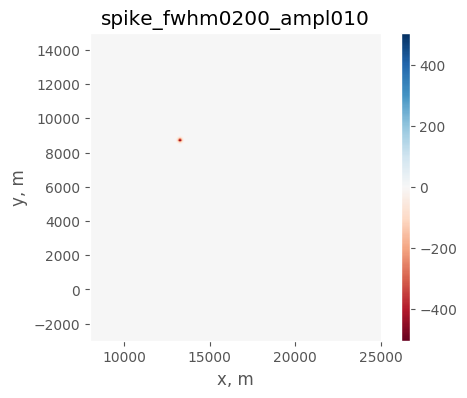

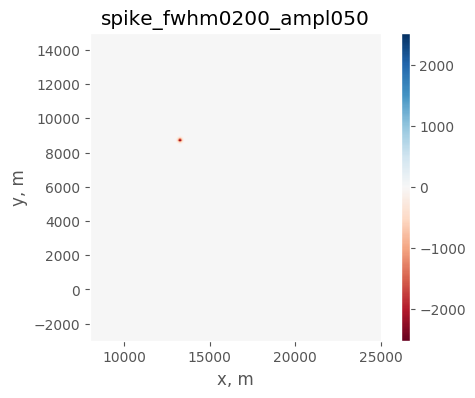

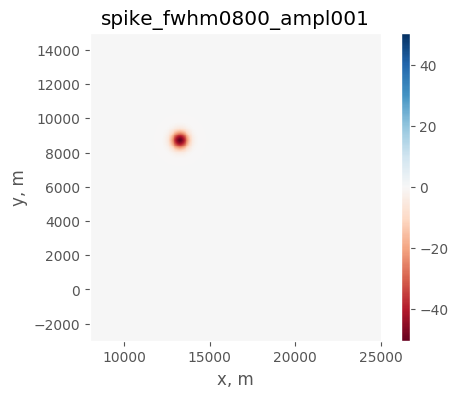

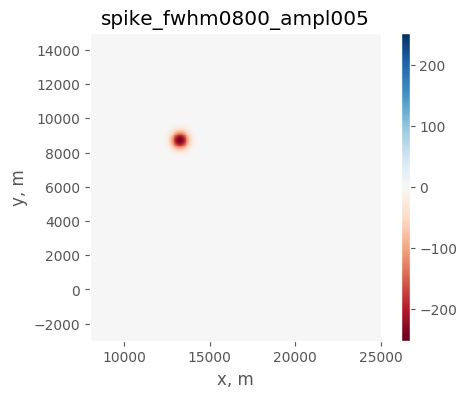

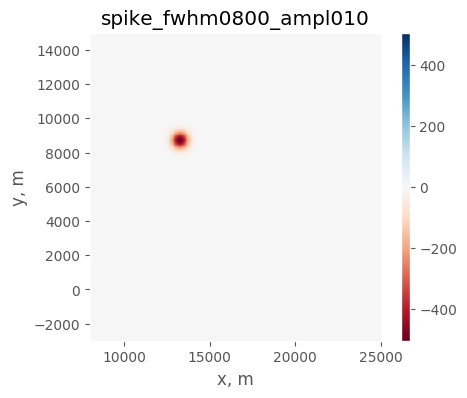

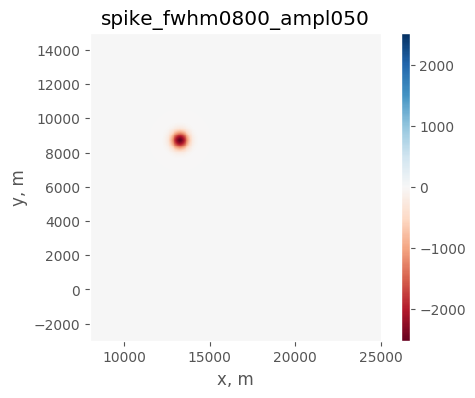

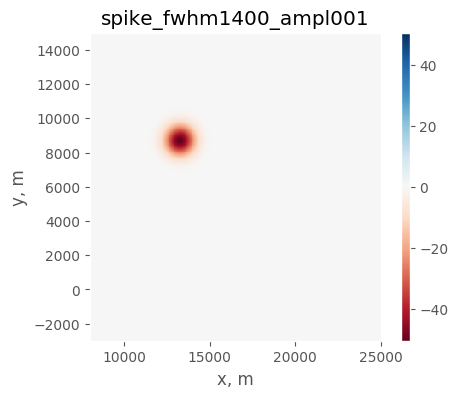

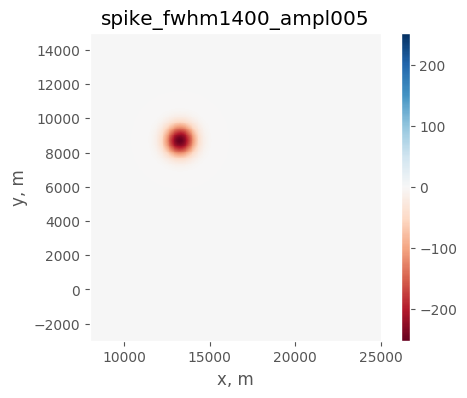

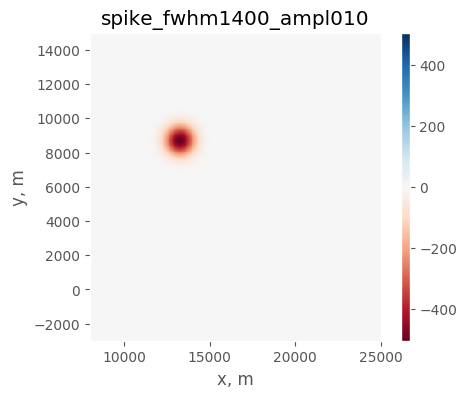

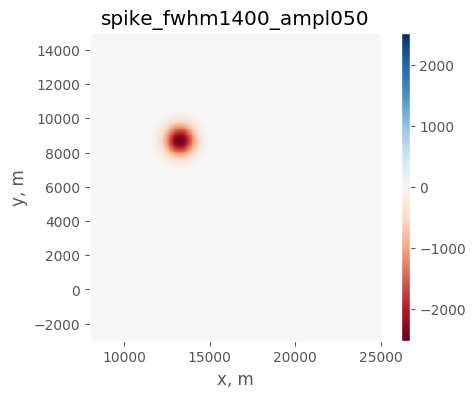

In [26]:
%%time 
for name, f in sorted(en.flow.items()):
    ow = 0
    kws = dict(overwrite=ow, overwrite_mmp=ow)
    tvp = f.syn.i.tvp.read(**kws)
    bckg = f.syn.i.tvp.bckg.read(**kws)
    dif = Arr3d(tvp-bckg, extent=f.syn.i.tvp.extent)
    figure(14,4)
    dif.plot(value=z0, axis=2, unit='m', cmap='RdBu', center_cmap=1)
    plt.title(name)
    plt.grid(False)

## Run

### Logs

In [23]:
no = 0
for k, p in sorted(en.syn.items()):
    p.reinit(path_eph)

## Out

### Files list

In [29]:
%%time 
for k, p in sorted(en.syn.items()):
    if k != 'spike_fwhm1400_ampl050':
        continue
    p.reinit(path=path_eph)
    p.o.ls()


Content of /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch08_Kolumbo_volcano/spike_fwhm1400_ampl050syn/out

total 51G
-rwx------ 1 kmc3817 root 482K Nov 13 00:23 fwhm1400_ampl050syn-Synthetic_windowed.sgy
-rwx------ 1 kmc3817 root 183M Nov 13 00:23 fwhm1400_ampl050syn-Synthetic.sgy
-rwx------ 1 kmc3817 root 482K Nov 13 00:17 spike_fwhm1400_ampl050syn-Synthetic_windowed.sgy
-rwx------ 1 kmc3817 root  381 Nov 12 08:41 spike_fwhm1400_ampl050syn-JobOut1.log
-rwx------ 1 kmc3817 root 8.5K Nov 12 08:41 spike_fwhm1400_ampl050syn-JobErr1.log
-rwx------ 1 kmc3817 root  70K Nov 12 08:41 spike_fwhm1400_ampl050syn-Out1.log
-rwx------ 1 kmc3817 root 183M Nov 12 08:41 spike_fwhm1400_ampl050syn-Synthetic.sgy
-rwx------ 1 kmc3817 root 367K Nov 12 08:41 spike_fwhm1400_ampl050syn-Synthetic.idx
-rwx------ 1 kmc3817 root 105M Nov 12 08:41 spike_fwhm1400_ampl050syn-fw-003000-csref04123-iter00001-taskid00001.vtr
-rwx------ 1 kmc3817 root 105M Nov 12 08:41 spike_fwhm1400_ampl050syn-fw-003000-csref04109-iter0

### Data

#### Alg.
Copy all synthetic data from ephemeral. Otherwise file paths are too long for `sgy2vtr`.

In [52]:
# !python3 -m unittest fullwavepy.project.files.test.test_generic  -v

In [58]:
%%time 
for k, p in sorted(en.syn.items()):
    p.reinit(path_eph)
    source = p.o.syn.fname
    p.reinit('./')
    destin = p.o.syn.fname
    !cp {source} {destin}

CPU times: user 4.27 s, sys: 1.03 s, total: 5.3 s
Wall time: 3min 4s


#### Fig.
Compare `tstat` with `s01`. I don't know why they have fewer traces!?

In [60]:
s01.o.syn.surange() # tstat=17

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00491091 s, 652 kB/s

24080 traces:
tracl    3555 13370 (3555 - 13370)
tracr    2 1506 (2 - 1506)
fldr     17567 42821 (17567 - 42821)
tracf    4104 4178 (4104 - 4176)
ep       5 38 (5 - 38)
cdpt     0 1 (0 - 1)
trid     1
offset   10 21208 (10473 - 19597)
gelev    196 456 (417 - 410)
selev    -12
sdepth   12
swdep    45 503 (395 - 393)
gwdep    196 456 (417 - 410)
scalel   1
scalco   1
sx       8051 24996 (8201 - 8128)
sy       -2126 13847 (13742 - 13727)
gx       8863 24030 (18674 - 21101)
gy       -1040 13806 (13806 - -960)
counit   1
tstat    17
delrt    0 5 (0 - 4)
ns       3000
dt       2500
gain     0 1 (1 - 0)
igc      0 16 (16 - 0)
year     2015
day      331 340 (331 - 340)
hour     0 23 (3 - 15)
minute   0 59 (4 - 18)
sec      0 59 (55 - 43)
timbas   0 1000 (435 - 737)

Shot coordinate limits:
	North(23852,13847) South(10038,-2126) East(24996,656) West(8051,11996)

Receiver coordinate limits:
	North(1867

In [65]:
en.syn['spike_fwhm0200_ampl010'].o.syn.surange() # tstat=250

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00633777 s, 505 kB/s

15632 traces:
tracl    3555 13370 (3559 - 13361)
tracr    5 19287 (5 - 19287)
fldr     17567 42821 (17571 - 42812)
tracf    4104 4178 (4104 - 4176)
ep       5 38 (5 - 38)
cdpt     0 1 (0 - 1)
offset   5000 20252 (9814 - 18652)
gelev    -410 456 (417 - -410)
selev    -12
sdepth   12
swdep    45 503 (398 - 398)
gwdep    196 456 (417 - 410)
scalel   1
scalco   1
sx       8051 24996 (8860 - 9610)
sy       -2126 13847 (13743 - 13732)
gx       8863 24030 (18674 - 21101)
gy       -1040 13806 (13806 - -960)
counit   1
tstat    250
delrt    0 5 (0 - 4)
muts     1883 4860 (3383 - 4773)
mute     2883 5860 (4383 - 5773)
ns       3000
dt       2500
gain     0 1 (1 - 0)
igc      0 16 (16 - 0)
year     2015
day      331 340 (331 - 340)
hour     0 23 (3 - 15)
minute   0 59 (10 - 7)
sec      0 59 (54 - 24)
timbas   0 1000 (120 - 782)
ntr      19296

Shot coordinate limits:
	North(23852,13847) South(10038,-212

#### Fig.
Compare with `s01`.

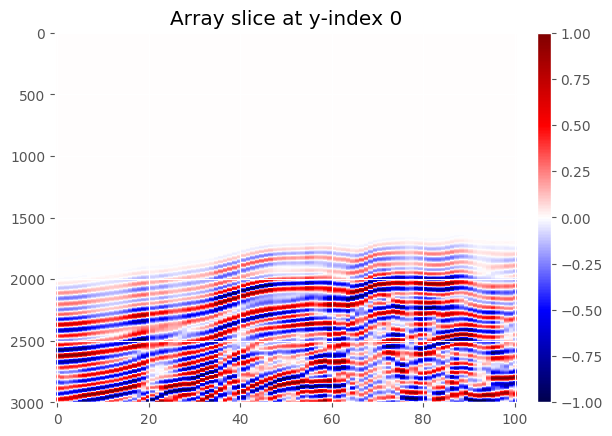

In [45]:
s01.o.syn.plot(**kws)

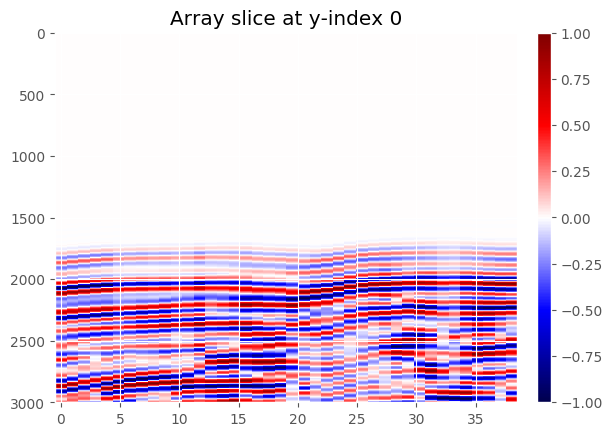

In [43]:
for k, p in sorted(en.syn.items()):
    p.reinit('./')
    kws = dict(win=dict(tracf=[4176], ep=[5]), norm='max')
    p.o.syn.plot(**kws)
    break

#### Fig.
Compare with `s01`.

In [62]:
kws = dict(win=dict(tracf=[4176], ep=[5]), norm='max')

282M	.//method_s01//out/method_s01-Synthetic.sgy


In [64]:
dt = .0025
dat_syn01 = Dat(s01.o.syn.read(**kws)[:,0,:], dt=dt)
# a2 = Dat(f2.read(**kws)[:,0,:])
# a1.normalise()
# a2.normalise()

In [65]:
dat_syn01.plot()

AttributeError: 'Data' object has no attribute 'read'

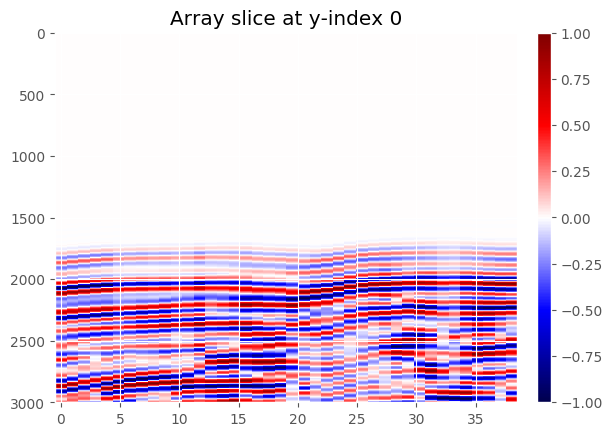

In [60]:
for k, p in sorted(en.syn.items()):
    p.reinit('./')
    kws = dict(win=dict(tracf=[4176], ep=[5]), norm='max')
    p.o.syn.plot(**kws)
    break

In [26]:
%%time 
from fullwavepy.ioapi.segy import SgyFile
from fullwavepy.seismic.data import Dat
name = f1.name.split('spike_')[-1]
# !cp {f1.fname} {f1.path}/{name}
f1 = SgyFile(name, f1.path)
# f2  = s01.o.syn
a1 = Dat(f1.read(**kws)[:,0,:])
# a2 = Dat(f2.read(**kws)[:,0,:])
# a1.normalise()
# a2.normalise()

NameError: name 'f1' is not defined

In [ ]:
figure(10,6)
il.plot(aspect='auto', label='amplitude, normalised')
plt.gca().invert_yaxis()
chunk_size = 10
ti = np.arange(len(il.arr))[::chunk_size] - .5     
ax = plt.gca()
ax.set_title('aldfj')
ax.set_xticks(ti)
ax.grid(axis='x', c='k', linestyle='-.', linewidth=1)  
empty_string_labels = ['']*len(ti)
ax.set_ylabel('time, s')
_ = ax.set_xticklabels(empty_string_labels)

### Wavefield

In [9]:
%%time 
for k, p in sorted(en.syn.items()):
    if k != 'spike_fwhm1400_ampl050':
        continue
    p.reinit(path=path_eph)
lll(40)

CPU times: user 28 ms, sys: 20 ms, total: 48 ms
Wall time: 266 ms


In [12]:
p.o.fw.it

[0.0, 0.0]

#### Dev-tests

In [27]:
from fullwavepy.seismic.wavefields import Wavefield
w = Wavefield()

In [18]:
path = '/home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch08_Kolumbo_volcano/'
path += 'spike_fwhm1400_ampl050syn/out/'
name = 'spike_fwhm1400_ampl050syn-fw-001000-csref04110-iter00001-taskid00001.vtr'
# !cp {path}/{name} /home/kmc3817/software/fullwavepy/fullwavepy/seismic/test/example_wavefield

In [28]:
%%time 
from fullwavepy.ioapi.generic import read_any
a = read_any(path+name, overwrite_mmp=0, overwrite=0)

OSError: Failed to split ./spike_fwhm1400_ampl001 using a full stop.

In [52]:
xp.read_all()
df = xp.recs
# df

In [53]:
df.loc[df.id==110].gx.values[0]
# df.loc[df.id==110].gy.values[0]

18939

In [1]:
from fullwavepy.utils import extent2absorb

In [34]:
extent = extent2absorb(b01.extent, dx=50, etop=0, e_abs=50)
wf = Arr3d(a, extent=extent)

In [61]:
svp = Arr3d(s01.i.tvp.read(), extent=b01.extent)

In [72]:
b01.xy

[[8000.0, 25000.0], [-3000.0, 15000.0]]

In [128]:
alphas = (np.abs(wf.arr) < 10).astype(int)
alphas.shape

(441, 461, 133)

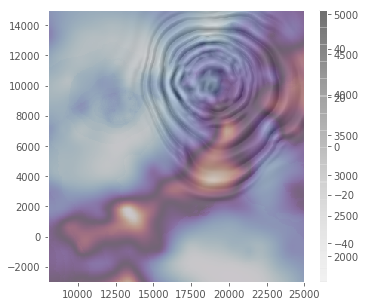

In [136]:
figure(15,5)
z = 400
svp.plot(z, axis=2, unit='m', cmap='twilight', mode='im', levels=20)
wf.plot(z, axis=2, unit='m', cmap='Greys', alpha=.3, mode='shade', center_cmap=1)
# svp.plot(18939, unit='m', cmap='Greys', mode='im+cr', levels=20)
# wf.plot(18939, unit='m', cmap='RdBu', alpha=.5, center_cmap=1) # 'twilight_shifted'
plt.xlim(*b01.extent[0])
plt.ylim(*b01.extent[1])
plt.grid(0)

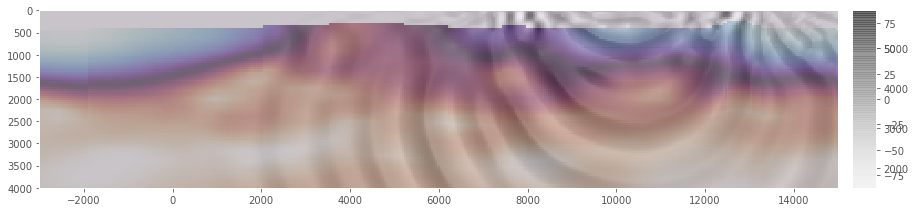

In [130]:
figure(15,5)
svp.plot(18939, unit='m', cmap='twilight', mode='im', levels=20)
wf.plot(18939, unit='m', cmap='Greys', alpha=.3, mode='shade', center_cmap=1)
# svp.plot(18939, unit='m', cmap='Greys', mode='im+cr', levels=20)
# wf.plot(18939, unit='m', cmap='RdBu', alpha=.5, center_cmap=1) # 'twilight_shifted'
plt.xlim(*b01.extent[1])
plt.ylim(*b01.extent[2][::-1])
plt.grid(0)

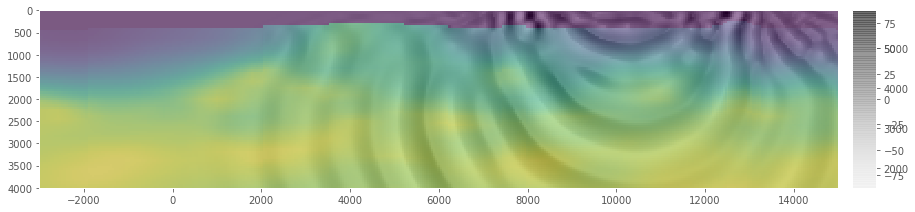

In [111]:
figure(15,5)
svp.plot(18939, unit='m', cmap='viridis', mode='im', levels=20)
wf.plot(18939, unit='m', cmap='Greys', alpha=.3, mode='shade', center_cmap=1)
# svp.plot(18939, unit='m', cmap='Greys', mode='im+cr', levels=20)
# wf.plot(18939, unit='m', cmap='RdBu', alpha=.5, center_cmap=1)
plt.xlim(*b01.extent[1])
plt.ylim(*b01.extent[2][::-1])
plt.grid(0)

In [47]:
!python3 -m unittest fullwavepy.seismic.test.test_wavefields  -v

test_get_file_names (fullwavepy.seismic.test.test_wavefields.TestWavefield) ... ok
test_get_files (fullwavepy.seismic.test.test_wavefields.TestWavefield) ... {4110: <fullwavepy.seismic.wavefields.WavefieldSnapshot object at 0x7fa3ab890128>}
ok
test_io_extracts (fullwavepy.seismic.test.test_wavefields.TestWavefield) ... ok

----------------------------------------------------------------------
Ran 3 tests in 0.000s

OK


# Invert synthetics

## Inp

### Prerequisites

In [113]:
%%time 
for key, p in sorted(en.inv.items()):
    syn = en.syn[key] # this is a source of 'observed' data
    p.reinit('./')
    p.ttime = 6.25 # NOTE !!!!!!!!!!!!!!!!!!!!!!!!!!! (2500 sec)
    p.i.svp.dupl(s01.i.tvp.fname) # common for all!
    p.i.rsg.dupl(syn.i.rsg.fname)
    p.i.obs.raw.dupl(syn.o.syn.fname) # NOTE !!!!!!!!
    p.i.rse.prep(fnames=[p.i.obs.raw.name])
    p.i.sp.prep(reciprocity=True, ztype='d', cat=1)    

Content of  .//spike_fwhm0200_ampl010inv//inp/spike_fwhm0200_ampl010inv-RawSeis.txt : 
spike_fwhm0200_ampl010inv-Observed_raw.sgy
 
Content of  .//spike_fwhm0200_ampl010inv//inp/spike_fwhm0200_ampl010inv-SegyPrep.key : 
FFID : yes
addtodepth : 0
debug : yes
dtms : 2.5
dx : 50.0
fixedarray : yes
geometry : segy
io : sgy
maxoffset : 1000000.0
minoffset : 0
nx1 : 341
nx2 : 361
nx3 : 81
outseis : yes
outsource : yes
problem : tomography
reciprocity : True
retain : yes
text : yes
ttime : 6250.0
unique : yes
xorigin : 8000.0
xshift : 0
yorigin : -3000.0
yshift : 0
ztype : d
 
Content of  .//spike_fwhm0200_ampl050inv//inp/spike_fwhm0200_ampl050inv-RawSeis.txt : 
spike_fwhm0200_ampl050inv-Observed_raw.sgy
 
Content of  .//spike_fwhm0200_ampl050inv//inp/spike_fwhm0200_ampl050inv-SegyPrep.key : 
FFID : yes
addtodepth : 0
debug : yes
dtms : 2.5
dx : 50.0
fixedarray : yes
geometry : segy
io : sgy
maxoffset : 1000000.0
minoffset : 0
nx1 : 341
nx2 : 361
nx3 : 81
outseis : yes
outsource : yes
problem

### Preprocess

Pre-process the input. In particular `obs.raw` file is pre-processed and output as `obs` file. This matters only if the discretisation differs from the one in the synthetic project.

In [137]:
%%time 
for key, p in sorted(en.inv.items()):
    p.reinit('./')
    p.i.sp.run()
    p.i.rnf.prep(b_abs=40, e_abs=50, cat=0)


 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to spike_fwhm0200_ampl010inv
 Preparing files for inversion...

 Grid points in-line:                    341
 Grid points cross-line:                 361
 Grid points vertically:                  81
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            17000.0000    
 Model width (metres):             18000.0000    
 Model depth (metres):             4000.00000    

 Modelling time step (ms):         2.50000000    
 Output data delta-T (ms):         2.50000000    
 Output data length (ms):          6250.00000    
 Output data length (samples):          2500
 Time steps to model:                   2500

 Receiver-array fixed in space:          yes
 Renumber original channel numbers:       no
 Use FFID instead of SOURCE numbers:     yes
 FFID num


 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to spike_fwhm0800_ampl010inv
 Preparing files for inversion...

 Grid points in-line:                    341
 Grid points cross-line:                 361
 Grid points vertically:                  81
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            17000.0000    
 Model width (metres):             18000.0000    
 Model depth (metres):             4000.00000    

 Modelling time step (ms):         2.50000000    
 Output data delta-T (ms):         2.50000000    
 Output data length (ms):          6250.00000    
 Output data length (samples):          2500
 Time steps to model:                   2500

 Receiver-array fixed in space:          yes
 Renumber original channel numbers:       no
 Use FFID instead of SOURCE numbers:     yes
 FFID num


 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to spike_fwhm1400_ampl010inv
 Preparing files for inversion...

 Grid points in-line:                    341
 Grid points cross-line:                 361
 Grid points vertically:                  81
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            17000.0000    
 Model width (metres):             18000.0000    
 Model depth (metres):             4000.00000    

 Modelling time step (ms):         2.50000000    
 Output data delta-T (ms):         2.50000000    
 Output data length (ms):          6250.00000    
 Output data length (samples):          2500
 Time steps to model:                   2500

 Receiver-array fixed in space:          yes
 Renumber original channel numbers:       no
 Use FFID instead of SOURCE numbers:     yes
 FFID num

### Process data

Process the observed data (`obs` file). This is quite slow (2.5 min), thus it may be a better idea to keep the processed data ready to be re-used. **Remember** that the data mimics `p14` observed data which was manually selected and had offsets > 5 km. 


In [29]:
from fullwavepy.seismic.data import Dat
from fullwavepy.ioapi.segy import SgyFile
key = 'spike_fwhm0200_ampl010'
syn = en.syn[key]
inv = en.inv[key]
dsyn = Dat(dt=.0025, file=SgyFile(syn.o.syn.name, syn.o.syn.path))
dobs = Dat(dt=.0025, file=SgyFile(inv.i.obs.name, inv.i.obs.path))
dp14 = Dat(dt=.0025, file=SgyFile('p14-Observed.sgy', 'data/'))

#### Fig.
Synthetic=observed vs. (real) field data.

(7.5, 0)

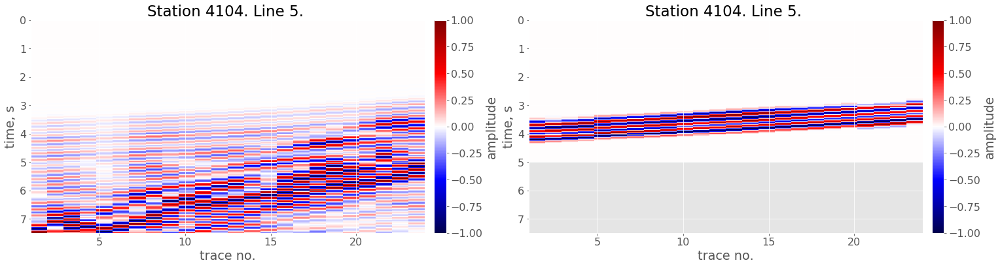

In [63]:
# plot 
figure(25,6)
plt.subplot(121)
dobs.plot(station=4104, line=5)
plt.subplot(122)
dp14.plot(station=4104, line=5)
plt.ylim(7.5,0)

#### Alg.
Extract first breaks from synthetic=observed data.

In [45]:
%%time 
fbreaks = syn.o.syn.get_fbreaks()

CPU times: user 1min 20s, sys: 464 ms, total: 1min 20s
Wall time: 1min 24s


#### Alg.
Convert first breaks to seconds and merge them with the header metadata.

In [30]:
dt = .0025
df = syn.o.syn.read_header()
df['fb'] = [int(i) * dt for i in fbreaks]

NameError: name 'fbreaks' is not defined

In [49]:
# df.tail(5)

#### Fig.
Synthetic=observed data with fbreaks overlain.

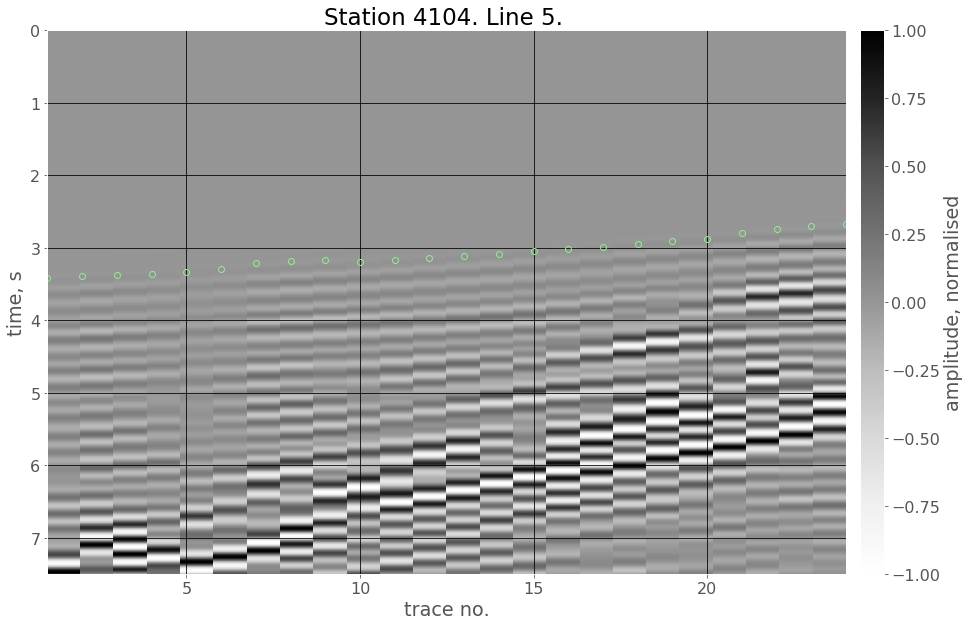

In [87]:
# plot 
import matplotlib as mpl
mpl.rcParams['font.family'] = 'sans-serif'
mpl.rcParams['font.size'] = 16
figure(15,10)
station = 4104
line = 5
dobs.plot(station=station, line=line, cmap='Greys', label='amplitude, normalised')
y = df.loc[(df.tracf==station) & (df.ep==line)]['fb']
x = range(1, len(y)+1)
plt.grid(color='k')
_ = plt.plot(x, y, 'o', markeredgecolor='lightgreen', markerfacecolor='none')

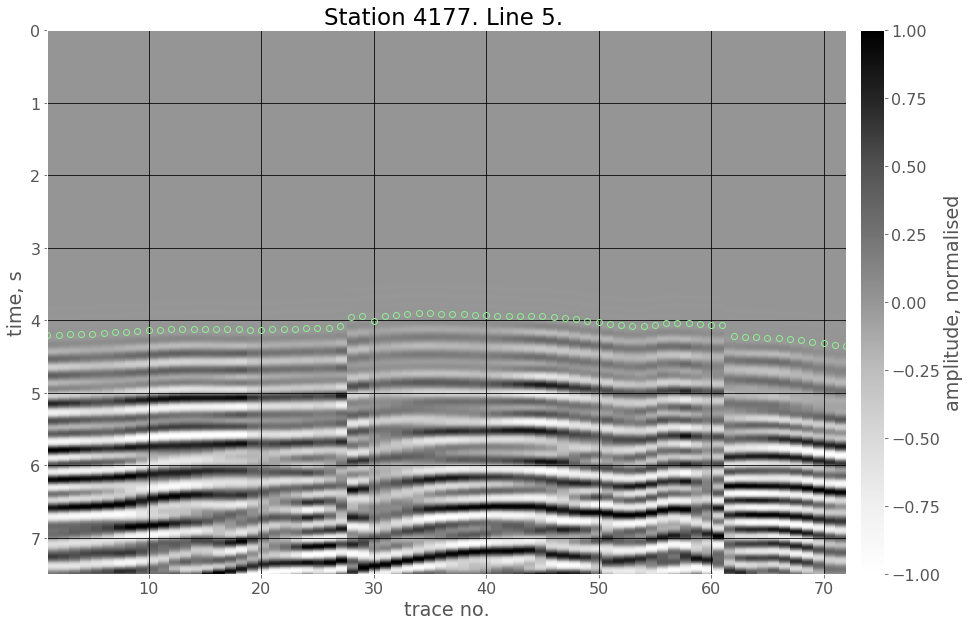

In [65]:
# plot 
import matplotlib as mpl
mpl.rcParams['font.family'] = 'sans-serif'
mpl.rcParams['font.size'] = 16
figure(15,10)
station = 4177
line = 5
dobs.plot(station=station, line=line, cmap='Greys', label='amplitude, normalised')
y = df.loc[(df.tracf==station) & (df.ep==line)]['fb']
x = range(1, len(y)+1)
plt.grid(color='k')
_ = plt.plot(x, y, 'o', markeredgecolor='lightgreen', markerfacecolor='none')

#### Alg.
Mute

In [84]:
!segyread tape={inv.i.obs.raw.fname} | sushw key=ntr a=15632 | segyhdrs | segywrite tape=test.sgy

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00717325 s, 446 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000170053 s, 18.8 MB/s


In [86]:
!cp test.sgy {dobs.file.fname}

In [85]:
!segyread tape=test.sgy | surange

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00511032 s, 626 kB/s
15632 traces:
tracl    3555 13370 (3559 - 13361)
tracr    1 15632 (1 - 15632)
fldr     17567 42821 (17571 - 42812)
tracf    4104 4178 (4104 - 4176)
ep       5 38 (5 - 38)
cdpt     0 1 (0 - 1)
offset   5000 20252 (9814 - 18652)
gelev    -410 456 (417 - -410)
selev    -12
sdepth   12
swdep    45 503 (398 - 398)
gwdep    196 456 (417 - 410)
scalel   1
scalco   1
sx       8051 24996 (8860 - 9610)
sy       -2126 13847 (13743 - 13732)
gx       8863 24030 (18674 - 21101)
gy       -1040 13806 (13806 - -960)
counit   1
tstat    250
delrt    0 5 (0 - 4)
muts     1883 4860 (3383 - 4773)
mute     2883 5860 (4383 - 5773)
ns       3000
dt       2500
gain     0 1 (1 - 0)
igc      0 16 (16 - 0)
year     2015
day      331 340 (331 - 340)
hour     0 23 (3 - 15)
minute   0 59 (10 - 7)
sec      0 59 (54 - 24)
timbas   0 1000 (120 - 782)
ntr      15632

Shot coordinate limits:
	North(23852,13847) South(10038,-2126

In [88]:
# dobs.file.surange()

In [89]:
from fullwavepy.seismic.data import DataMuterSUSGY, DataFileSgy
DataMuterSUSGY().mute(dobs.file.fname, tmute=df['fb'], twin=1)

In [96]:
name = 'spike_fwhm0200_ampl010inv-Observed_muted.sgy'

mut = Dat(dt=.0025, file=DataFileSgy(name, dobs.file.path))

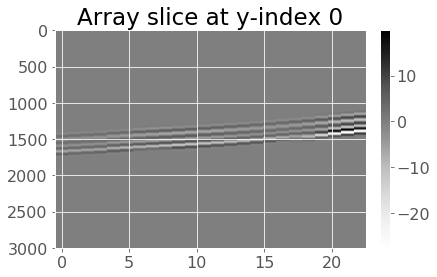

In [94]:
mut = SgyFile(name, dobs.file.path)
mut.plot(win=dict(tracf=[4104], ep=[5]), overwrite=1)

In [91]:
# !ls {dobs.file.path} -lth

#### Alg.
QC. It is wrong! Why ntr=19296????

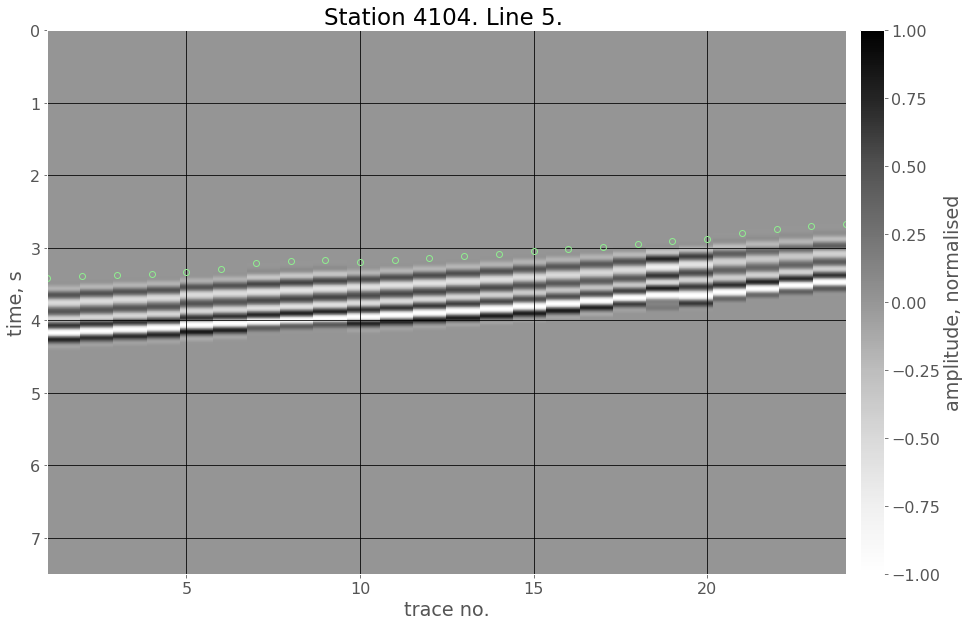

In [97]:
# plot 
import matplotlib as mpl
mpl.rcParams['font.family'] = 'sans-serif'
mpl.rcParams['font.size'] = 16
figure(15,10)
station = 4104
line = 5
mut.plot(station=station, line=line, cmap='Greys', label='amplitude, normalised')
y = df.loc[(df.tracf==station) & (df.ep==line)]['fb']
x = range(1, len(y)+1)
plt.grid(color='k')
_ = plt.plot(x, y, 'o', markeredgecolor='lightgreen', markerfacecolor='none')

#### Alg.
QC

CPU times: user 1.53 s, sys: 0 ns, total: 1.53 s
Wall time: 6.92 s


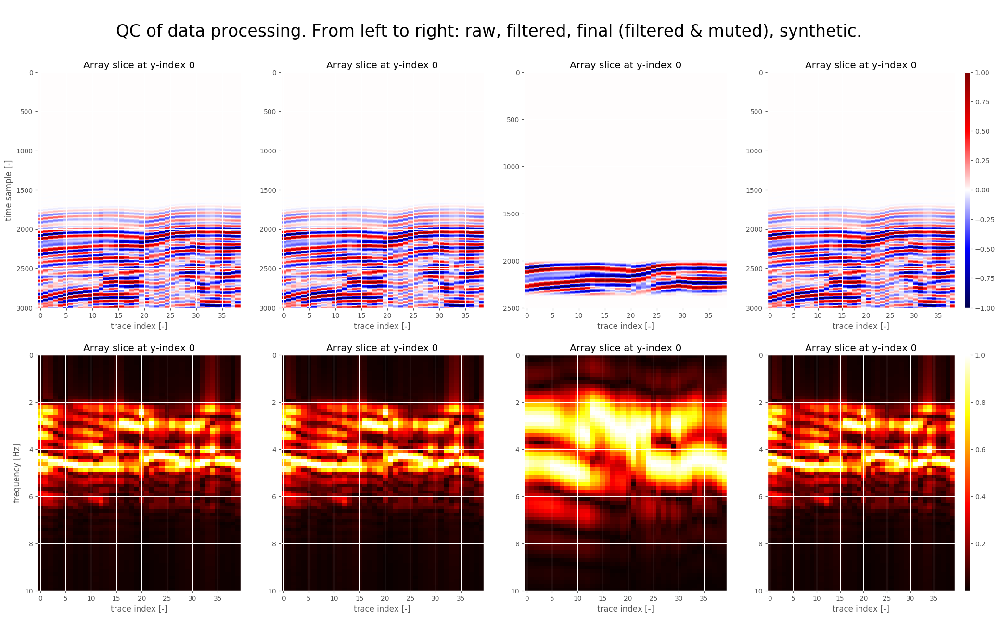

In [57]:
%%time 
for key, p in sorted(en.inv.items()):
    p.reinit('./')
    qc_filt(p, en.syn[key], sid=4176, ep=5, overwrite=1, overwrite_mmp=1)
    break

### Process data - automated

#### Alg.
Muting for all projects of the ensemble. 1-sec window just as in the field-data inversion.

spike_fwhm0200_ampl010
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00535903 s, 597 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000647175 s, 4.9 MB/s
spike_fwhm0200_ampl050
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00302845 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.7386e-05 s, 36.6 MB/s
spike_fwhm0800_ampl001
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0034719 s, 922 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000307805 s, 10.4 MB/s
spike_fwhm0800_ampl005
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00451153 s, 709 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000335747 s, 9.5 MB/s
spike_fwhm0800_ampl010
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00270446 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 

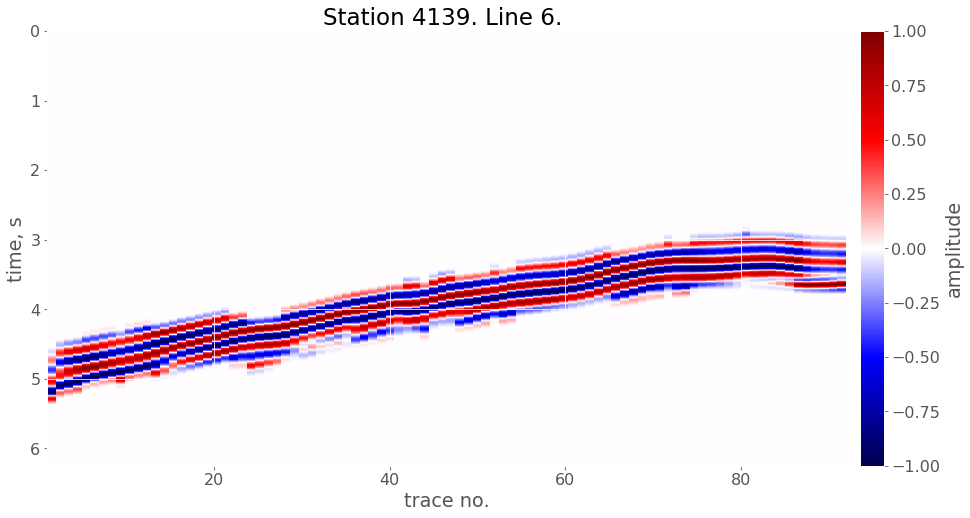

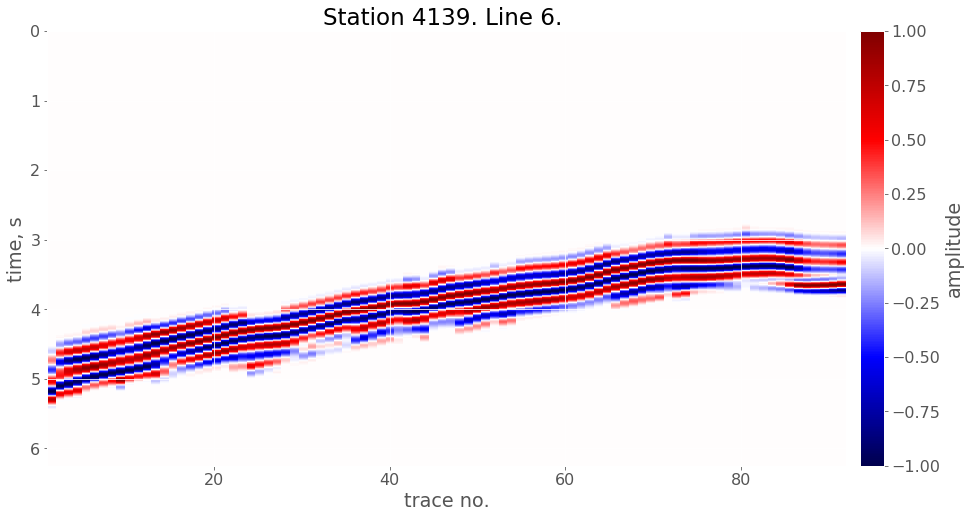

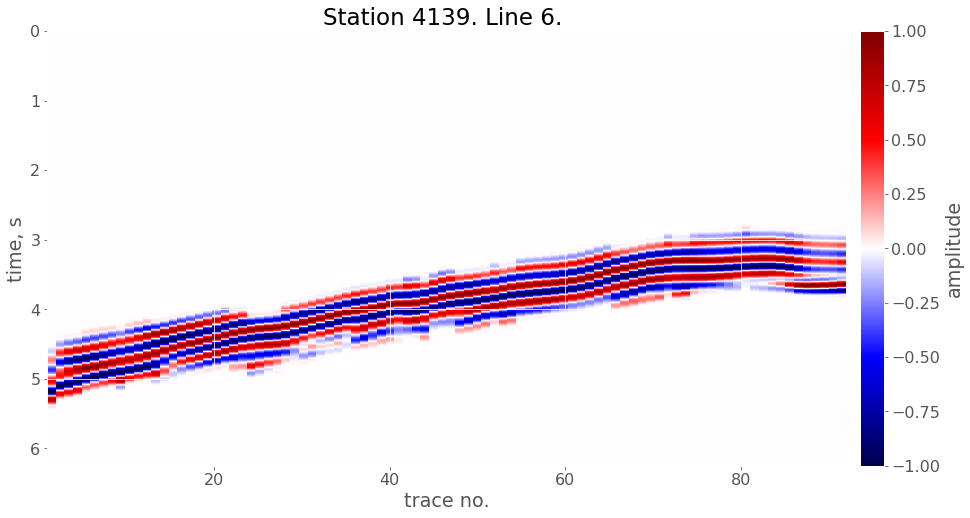

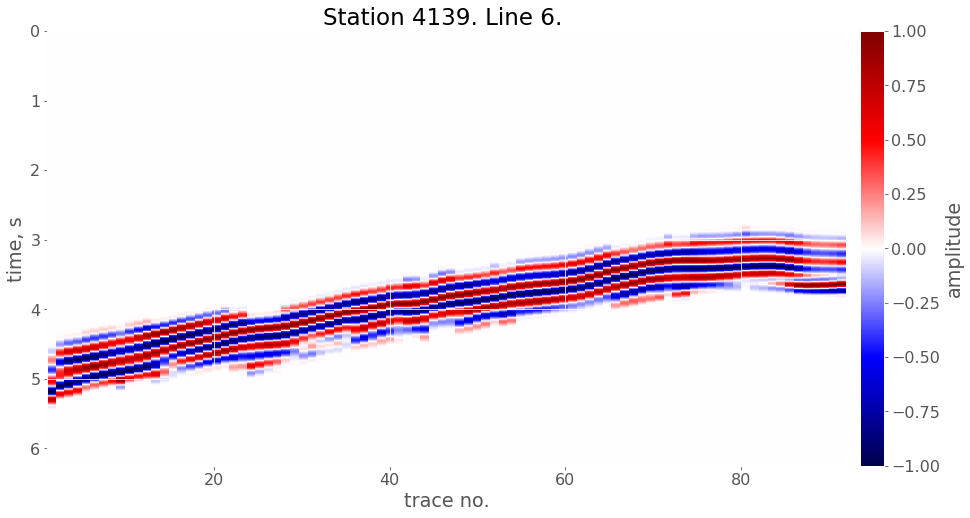

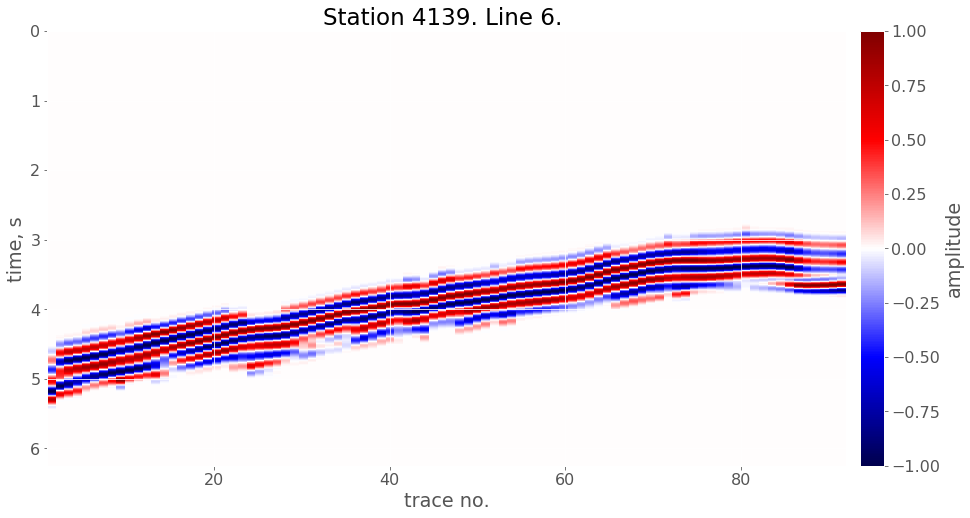

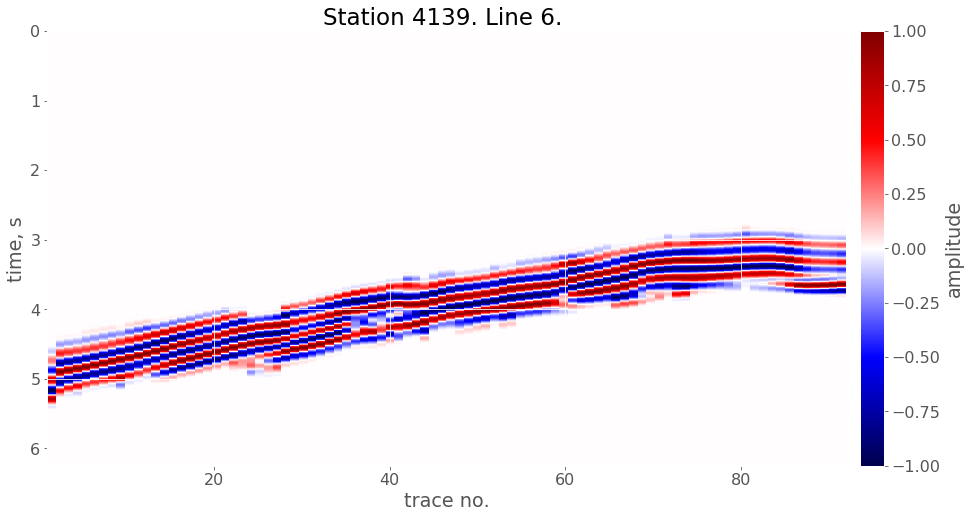

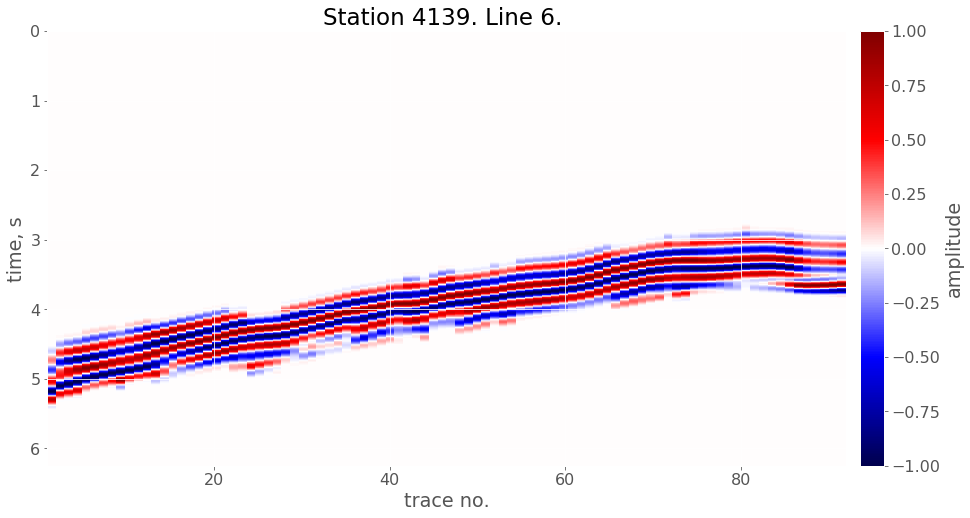

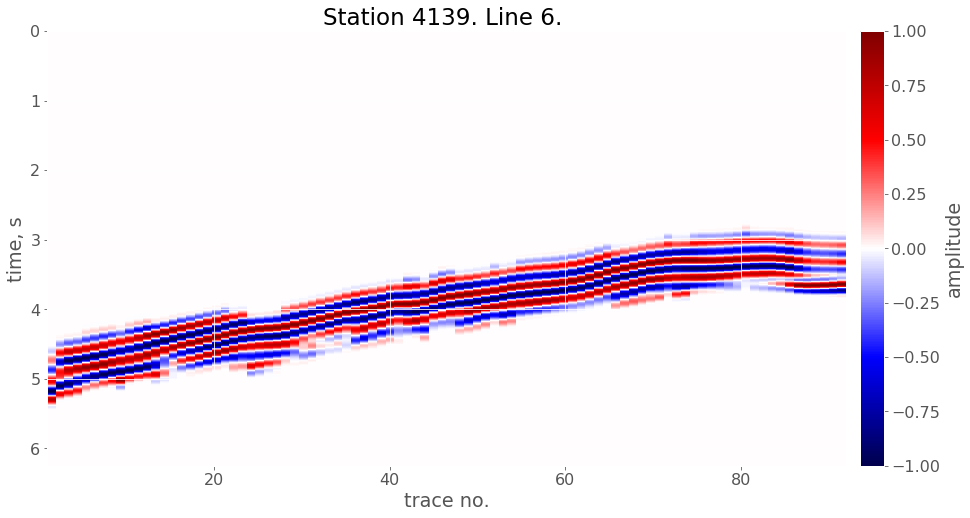

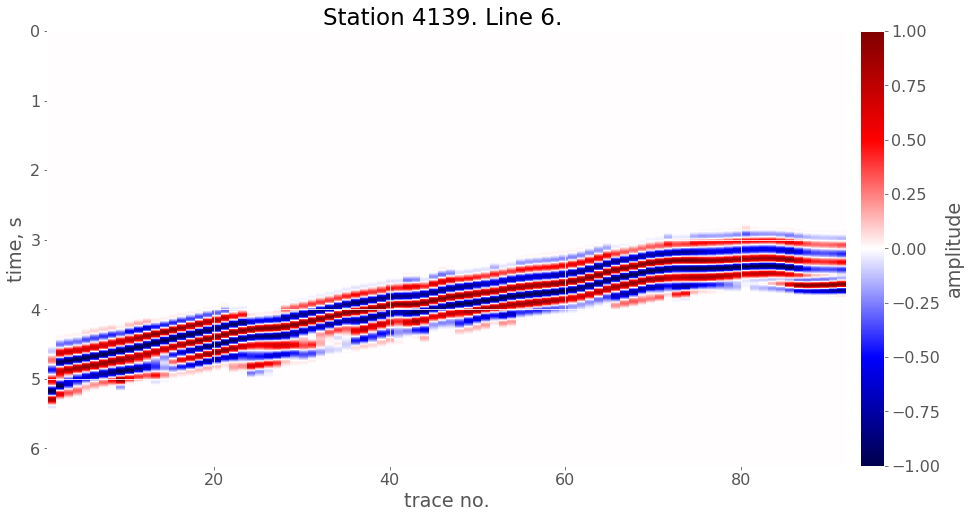

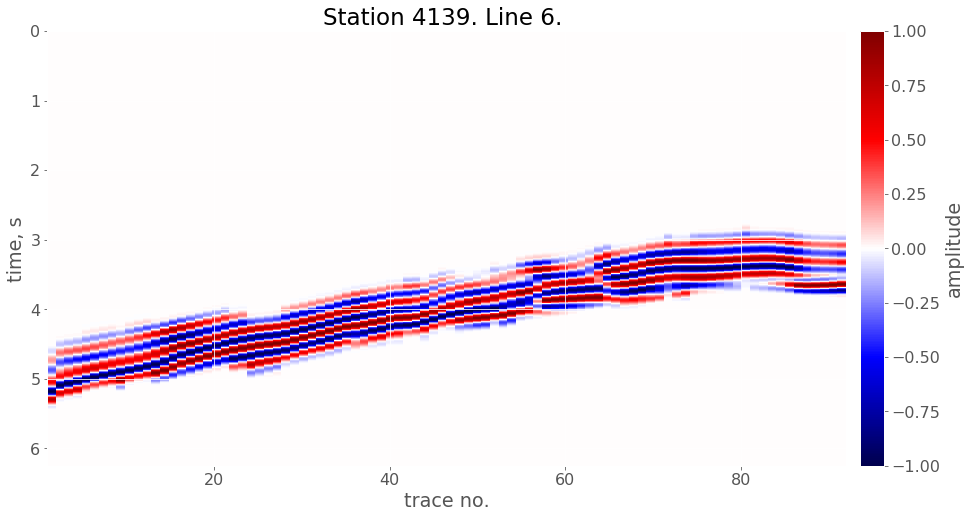

In [139]:
%%time 
# took 15 minutes
from fullwavepy.seismic.data import Dat, DataMuterSUSGY
from fullwavepy.ioapi.segy import SgyFile
dp14 = Dat(dt=.0025, file=SgyFile('p14-Observed.sgy', 'data/'))
for key, inv in sorted(en.inv.items()):
    print(key)
    syn = en.syn[key]
    dsyn = Dat(dt=.0025, file=SgyFile(syn.o.syn.name, syn.o.syn.path))
    dobs = Dat(dt=.0025, file=SgyFile(inv.i.obs.name, inv.i.obs.path))
    fbreaks = syn.o.syn.get_fbreaks()
    # NOTE
    # we process 'raw' data, that's why the number of samples is still 3000, not 25000
    #!segyread tape={inv.i.obs.raw.fname} | sushw key=ntr a=15632 | segyhdrs | segywrite tape=test.sgy
    !segyread tape={inv.i.obs.fname} | sushw key=ntr a=15632 | segyhdrs | segywrite tape=test.sgy
    !cp test.sgy {dobs.file.fname}
    DataMuterSUSGY().mute(dobs.file.fname, tmute=df['fb'], twin=1)
    name = dobs.file.name[:-4] + '_muted.sgy'
    mut = SgyFile(name, dobs.file.path)
    !cp {mut.fname} {dobs.file.fname}
    figure(15,8)
    tracf = 4139
    ep = 6
    dobs.plot(station=tracf, line=ep)
    #mut.plot(win=dict(tracf=[tracf], ep=[ep]), overwrite=1, norm='max')
    #plt.title('%s, OBS %s, line %s' % (key,tracf-4000,ep))

### Investigate LVZ-imprint in data

Two anomaly end-members are here compared: small weak vs. large strong anomaly. The first-arrival times are very similar due to wavefront healing but  **the difference is present in the 1-sec window**, consisting of diffraction-induced wavefront perturbations.

#### Fig.
OBS 139, line 6. Note the shorter wavelengths through the larger&stronger LVZ!

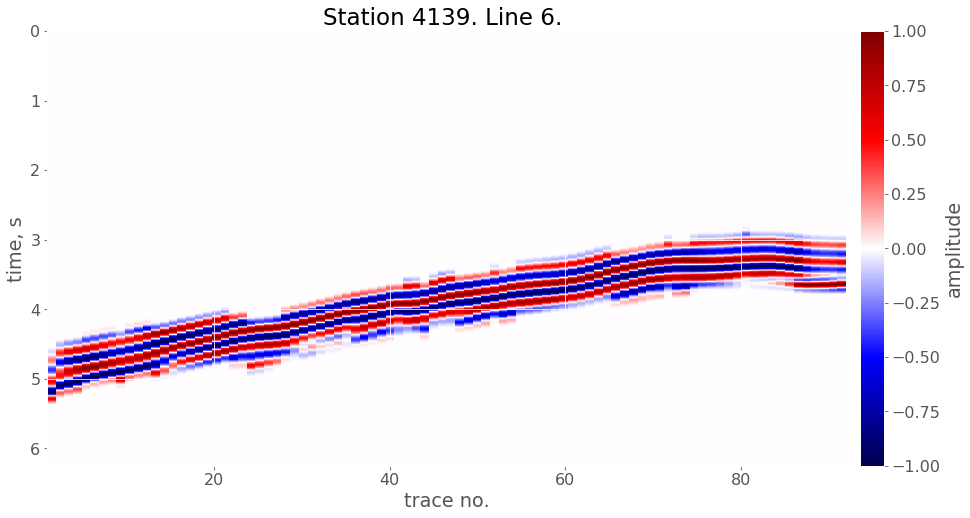

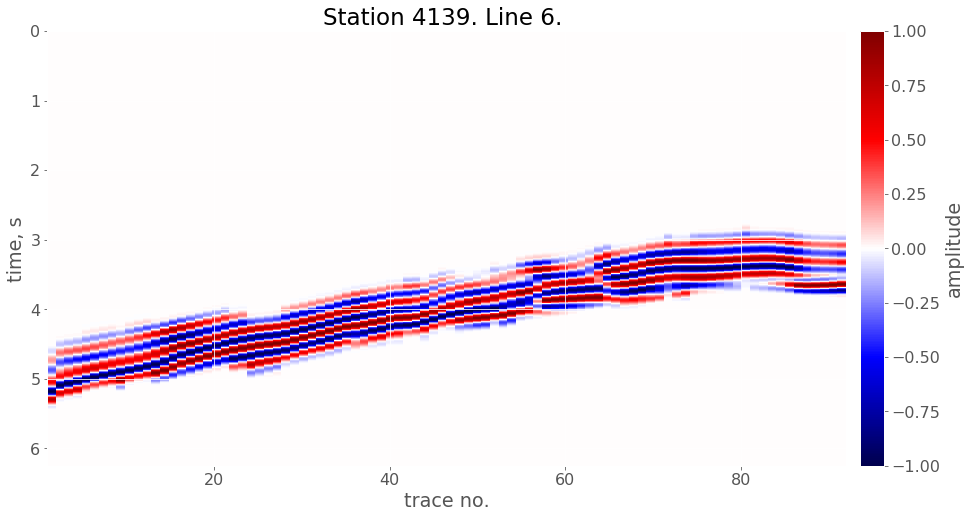

In [140]:
tracf = 4139
ep = 6
for key in ['spike_fwhm0200_ampl010', 'spike_fwhm1400_ampl050']:
    inv = en.inv[key]
    dobs = Dat(dt=.0025, file=SgyFile(inv.i.obs.name, inv.i.obs.path))
    figure(15,8)
    dobs.plot(station=tracf, line=ep)

#### Fig.
OBS 139, line 6

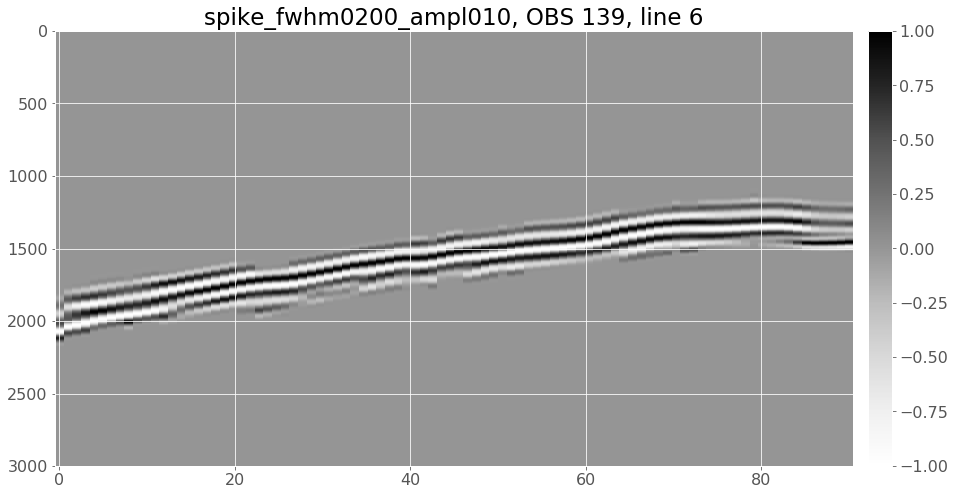

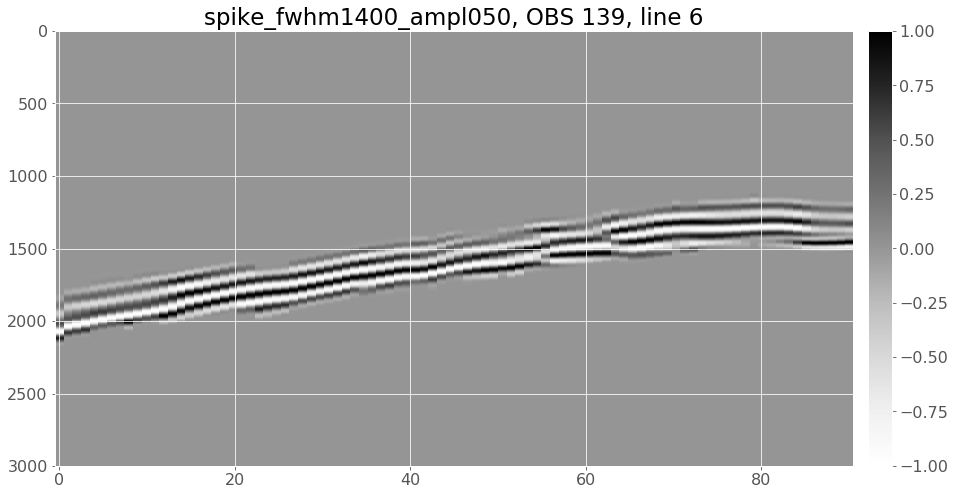

In [130]:
tracf = 4139
ep = 6
for key in ['spike_fwhm0200_ampl010', 'spike_fwhm1400_ampl050']:
    inv = en.inv[key]
    dobs = Dat(dt=.0025, file=SgyFile(inv.i.obs.name, inv.i.obs.path))
    name = dobs.file.name[:-4] + '_muted.sgy'
    mut = SgyFile(name, dobs.file.path)
    figure(15,8)

    mut.plot(win=dict(tracf=[tracf], ep=[ep]), overwrite=1, norm='max')
    plt.title('%s, OBS %s, line %s' % (key,tracf-4000,ep))

#### Fig.
OBS 112, line 7

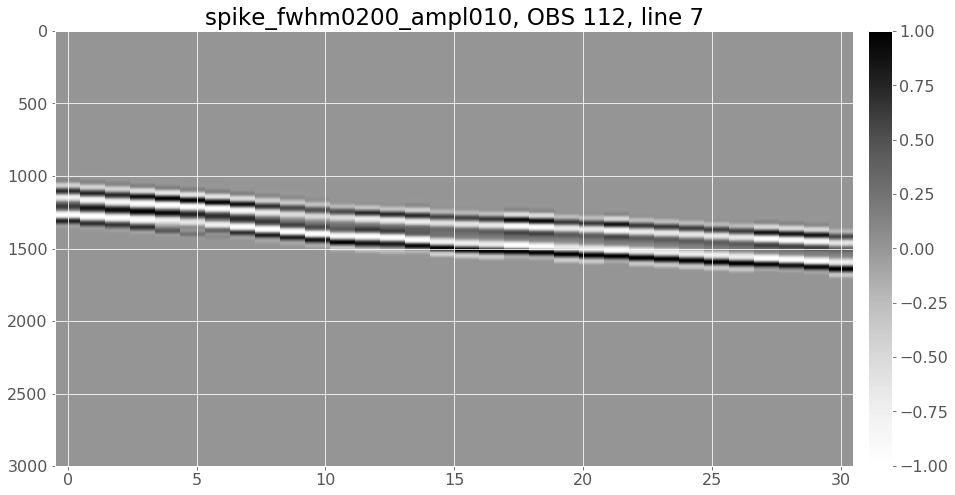

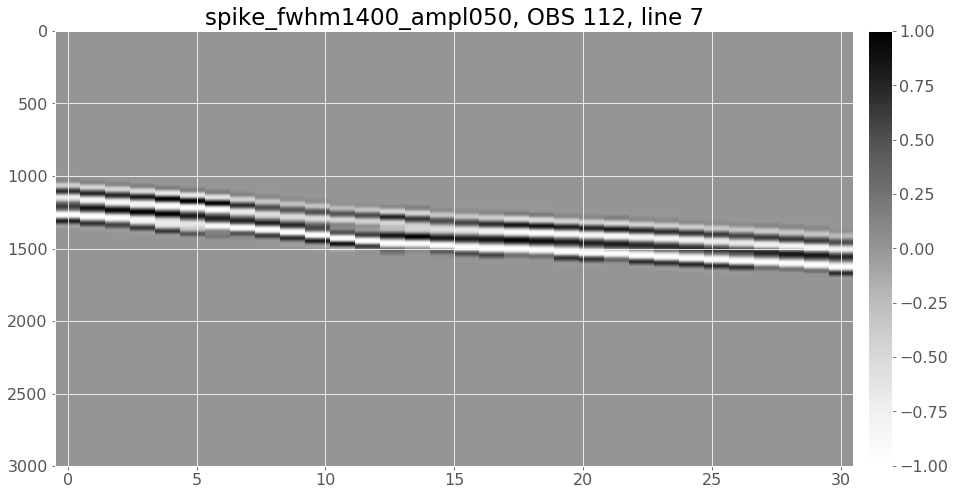

In [131]:
tracf = 4112
ep = 7
for key in ['spike_fwhm0200_ampl010', 'spike_fwhm1400_ampl050']:
    inv = en.inv[key]
    dobs = Dat(dt=.0025, file=SgyFile(inv.i.obs.name, inv.i.obs.path))
    name = dobs.file.name[:-4] + '_muted.sgy'
    mut = SgyFile(name, dobs.file.path)
    figure(15,8)
    mut.plot(win=dict(tracf=[tracf], ep=[ep]), overwrite=1, norm='max')
    plt.title('%s, OBS %s, line %s' % (key,tracf-4000,ep))

#### Fig.
OBS 105, line 7. This is quite subtle!

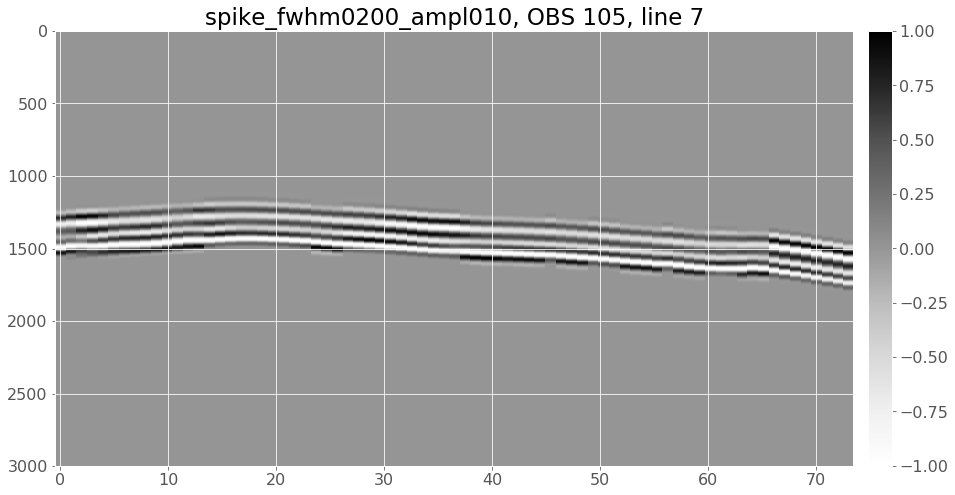

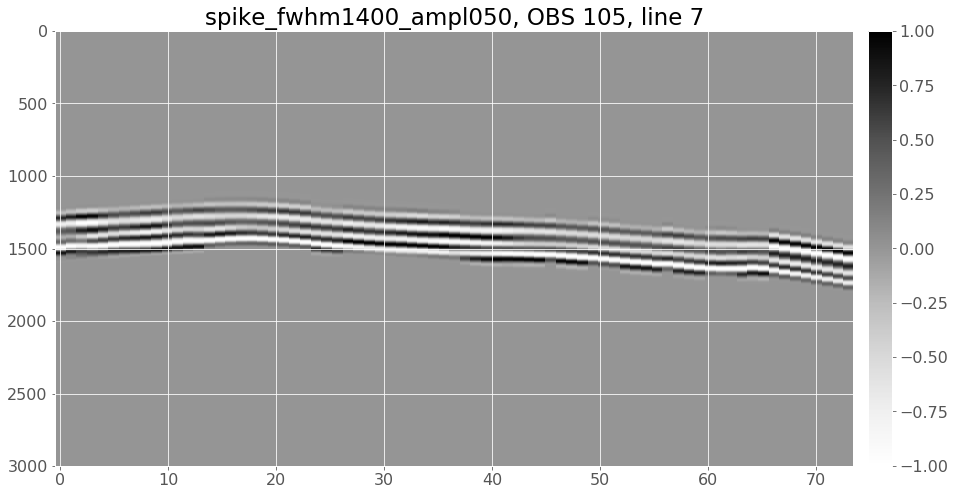

In [134]:
tracf = 4105
ep = 7
for key in ['spike_fwhm0200_ampl010', 'spike_fwhm1400_ampl050']:
    inv = en.inv[key]
    dobs = Dat(dt=.0025, file=SgyFile(inv.i.obs.name, inv.i.obs.path))
    name = dobs.file.name[:-4] + '_muted.sgy'
    mut = SgyFile(name, dobs.file.path)
    figure(15,8)
    mut.plot(win=dict(tracf=[tracf], ep=[ep]), overwrite=1, norm='max')
    plt.title('%s, OBS %s, line %s' % (key,tracf-4000,ep))

#### Fig.
OBS 138, line 6. Some first-break-picking errors.

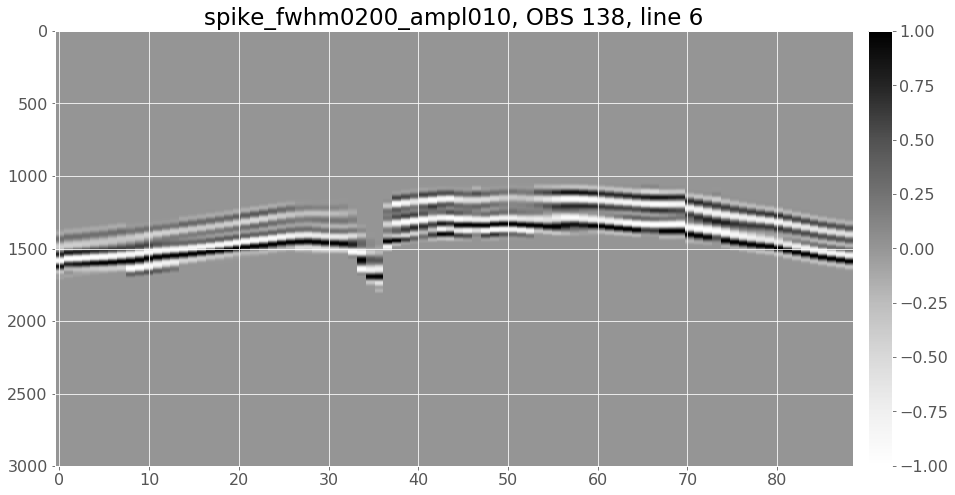

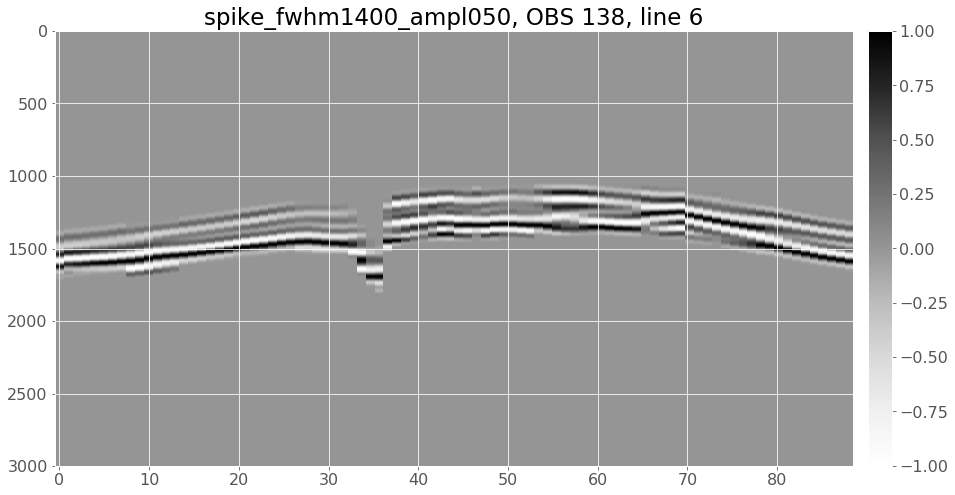

In [135]:
tracf = 4138
ep = 6
for key in ['spike_fwhm0200_ampl010', 'spike_fwhm1400_ampl050']:
    inv = en.inv[key]
    dobs = Dat(dt=.0025, file=SgyFile(inv.i.obs.name, inv.i.obs.path))
    name = dobs.file.name[:-4] + '_muted.sgy'
    mut = SgyFile(name, dobs.file.path)
    figure(15,8)
    mut.plot(win=dict(tracf=[tracf], ep=[ep]), overwrite=1, norm='max')
    plt.title('%s, OBS %s, line %s' % (key,tracf-4000,ep))

### Check

In [141]:
%%time 
lll(20)
for key, p in sorted(en.inv.items()):
    p.i.check_by_fullwave()
    p.i.obs.surange() # above doesn't check if data exist
lll(40)

INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: 

Fullwave is checking the input...
(exe = /home/kmc3817/light_PhD/fullwave3D/rev690/bin/fullwave3D.exe)
INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: Checked input & dumped canonical runfile


INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: +++++++++++++++ Will only check input files and dump canonical runfile ++++++++++++++++
---=== Starting run (host: ese-kajetan) on 2021/11/29, 17:42:26 ===---
executable: fullwave3D.exe, version: unknown, release date: 2021-08-31
=== scheduler_getprojargs: Project name (command-line argument): "spike_fwhm0200_ampl010inv"
=== setup_probtype: Equation: "acoustic", Anisotropy: "none", Domain: "time", Kernel: "low"
+++ ReadParms: WARNING, unknown keyword in Runfile: "ibfs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "multisurf"
+++ ReadParms: WARNING, unknown keyword in Runfile: "nosprdfctrs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "seaLevel"
+++ ReadParms: WARNING, unknown keyword in Runfile: "maxGhostIter"
+++ ReadParms: WARNING, unknown keyword in Runfile: "vacuum"
+++ ReadParms: WARNING, unknown keyword in Runfile: "accuracy"
+++ ReadParms: WARNING, unknown keyword in Runfile: "minGhostFS"
+++ ReadParms

INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: +++++++++++++++ Will only check input files and dump canonical runfile ++++++++++++++++
---=== Starting run (host: ese-kajetan) on 2021/11/29, 17:42:29 ===---
executable: fullwave3D.exe, version: unknown, release date: 2021-08-31
=== scheduler_getprojargs: Project name (command-line argument): "spike_fwhm0200_ampl050inv"
=== setup_probtype: Equation: "acoustic", Anisotropy: "none", Domain: "time", Kernel: "low"
+++ ReadParms: WARNING, unknown keyword in Runfile: "ibfs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "multisurf"
+++ ReadParms: WARNING, unknown keyword in Runfile: "nosprdfctrs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "seaLevel"
+++ ReadParms: WARNING, unknown keyword in Runfile: "maxGhostIter"
+++ ReadParms: WARNING, unknown keyword in Runfile: "vacuum"
+++ ReadParms: WARNING, unknown keyword in Runfile: "accuracy"
+++ ReadParms: WARNING, unknown keyword in Runfile: "minGhostFS"
+++ ReadParms

INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: +++++++++++++++ Will only check input files and dump canonical runfile ++++++++++++++++
---=== Starting run (host: ese-kajetan) on 2021/11/29, 17:42:32 ===---
executable: fullwave3D.exe, version: unknown, release date: 2021-08-31
=== scheduler_getprojargs: Project name (command-line argument): "spike_fwhm0800_ampl001inv"
=== setup_probtype: Equation: "acoustic", Anisotropy: "none", Domain: "time", Kernel: "low"
+++ ReadParms: WARNING, unknown keyword in Runfile: "ibfs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "multisurf"
+++ ReadParms: WARNING, unknown keyword in Runfile: "nosprdfctrs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "seaLevel"
+++ ReadParms: WARNING, unknown keyword in Runfile: "maxGhostIter"
+++ ReadParms: WARNING, unknown keyword in Runfile: "vacuum"
+++ ReadParms: WARNING, unknown keyword in Runfile: "accuracy"
+++ ReadParms: WARNING, unknown keyword in Runfile: "minGhostFS"
+++ ReadParms

INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: +++++++++++++++ Will only check input files and dump canonical runfile ++++++++++++++++
---=== Starting run (host: ese-kajetan) on 2021/11/29, 17:42:35 ===---
executable: fullwave3D.exe, version: unknown, release date: 2021-08-31
=== scheduler_getprojargs: Project name (command-line argument): "spike_fwhm0800_ampl005inv"
=== setup_probtype: Equation: "acoustic", Anisotropy: "none", Domain: "time", Kernel: "low"
+++ ReadParms: WARNING, unknown keyword in Runfile: "ibfs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "multisurf"
+++ ReadParms: WARNING, unknown keyword in Runfile: "nosprdfctrs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "seaLevel"
+++ ReadParms: WARNING, unknown keyword in Runfile: "maxGhostIter"
+++ ReadParms: WARNING, unknown keyword in Runfile: "vacuum"
+++ ReadParms: WARNING, unknown keyword in Runfile: "accuracy"
+++ ReadParms: WARNING, unknown keyword in Runfile: "minGhostFS"
+++ ReadParms

INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: +++++++++++++++ Will only check input files and dump canonical runfile ++++++++++++++++
---=== Starting run (host: ese-kajetan) on 2021/11/29, 17:42:37 ===---
executable: fullwave3D.exe, version: unknown, release date: 2021-08-31
=== scheduler_getprojargs: Project name (command-line argument): "spike_fwhm0800_ampl010inv"
=== setup_probtype: Equation: "acoustic", Anisotropy: "none", Domain: "time", Kernel: "low"
+++ ReadParms: WARNING, unknown keyword in Runfile: "ibfs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "multisurf"
+++ ReadParms: WARNING, unknown keyword in Runfile: "nosprdfctrs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "seaLevel"
+++ ReadParms: WARNING, unknown keyword in Runfile: "maxGhostIter"
+++ ReadParms: WARNING, unknown keyword in Runfile: "vacuum"
+++ ReadParms: WARNING, unknown keyword in Runfile: "accuracy"
+++ ReadParms: WARNING, unknown keyword in Runfile: "minGhostFS"
+++ ReadParms

INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: +++++++++++++++ Will only check input files and dump canonical runfile ++++++++++++++++
---=== Starting run (host: ese-kajetan) on 2021/11/29, 17:42:40 ===---
executable: fullwave3D.exe, version: unknown, release date: 2021-08-31
=== scheduler_getprojargs: Project name (command-line argument): "spike_fwhm0800_ampl050inv"
=== setup_probtype: Equation: "acoustic", Anisotropy: "none", Domain: "time", Kernel: "low"
+++ ReadParms: WARNING, unknown keyword in Runfile: "ibfs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "multisurf"
+++ ReadParms: WARNING, unknown keyword in Runfile: "nosprdfctrs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "seaLevel"
+++ ReadParms: WARNING, unknown keyword in Runfile: "maxGhostIter"
+++ ReadParms: WARNING, unknown keyword in Runfile: "vacuum"
+++ ReadParms: WARNING, unknown keyword in Runfile: "accuracy"
+++ ReadParms: WARNING, unknown keyword in Runfile: "minGhostFS"
+++ ReadParms

INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: +++++++++++++++ Will only check input files and dump canonical runfile ++++++++++++++++
---=== Starting run (host: ese-kajetan) on 2021/11/29, 17:42:43 ===---
executable: fullwave3D.exe, version: unknown, release date: 2021-08-31
=== scheduler_getprojargs: Project name (command-line argument): "spike_fwhm1400_ampl001inv"
=== setup_probtype: Equation: "acoustic", Anisotropy: "none", Domain: "time", Kernel: "low"
+++ ReadParms: WARNING, unknown keyword in Runfile: "ibfs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "multisurf"
+++ ReadParms: WARNING, unknown keyword in Runfile: "nosprdfctrs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "seaLevel"
+++ ReadParms: WARNING, unknown keyword in Runfile: "maxGhostIter"
+++ ReadParms: WARNING, unknown keyword in Runfile: "vacuum"
+++ ReadParms: WARNING, unknown keyword in Runfile: "accuracy"
+++ ReadParms: WARNING, unknown keyword in Runfile: "minGhostFS"
+++ ReadParms

INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: +++++++++++++++ Will only check input files and dump canonical runfile ++++++++++++++++
---=== Starting run (host: ese-kajetan) on 2021/11/29, 17:42:46 ===---
executable: fullwave3D.exe, version: unknown, release date: 2021-08-31
=== scheduler_getprojargs: Project name (command-line argument): "spike_fwhm1400_ampl005inv"
=== setup_probtype: Equation: "acoustic", Anisotropy: "none", Domain: "time", Kernel: "low"
+++ ReadParms: WARNING, unknown keyword in Runfile: "ibfs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "multisurf"
+++ ReadParms: WARNING, unknown keyword in Runfile: "nosprdfctrs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "seaLevel"
+++ ReadParms: WARNING, unknown keyword in Runfile: "maxGhostIter"
+++ ReadParms: WARNING, unknown keyword in Runfile: "vacuum"
+++ ReadParms: WARNING, unknown keyword in Runfile: "accuracy"
+++ ReadParms: WARNING, unknown keyword in Runfile: "minGhostFS"
+++ ReadParms

INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: +++++++++++++++ Will only check input files and dump canonical runfile ++++++++++++++++
---=== Starting run (host: ese-kajetan) on 2021/11/29, 17:42:49 ===---
executable: fullwave3D.exe, version: unknown, release date: 2021-08-31
=== scheduler_getprojargs: Project name (command-line argument): "spike_fwhm1400_ampl010inv"
=== setup_probtype: Equation: "acoustic", Anisotropy: "none", Domain: "time", Kernel: "low"
+++ ReadParms: WARNING, unknown keyword in Runfile: "ibfs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "multisurf"
+++ ReadParms: WARNING, unknown keyword in Runfile: "nosprdfctrs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "seaLevel"
+++ ReadParms: WARNING, unknown keyword in Runfile: "maxGhostIter"
+++ ReadParms: WARNING, unknown keyword in Runfile: "vacuum"
+++ ReadParms: WARNING, unknown keyword in Runfile: "accuracy"
+++ ReadParms: WARNING, unknown keyword in Runfile: "minGhostFS"
+++ ReadParms

INFO:fullwavepy.project.generic.io.ProjInput.check_by_fullwave: +++++++++++++++ Will only check input files and dump canonical runfile ++++++++++++++++
---=== Starting run (host: ese-kajetan) on 2021/11/29, 17:42:52 ===---
executable: fullwave3D.exe, version: unknown, release date: 2021-08-31
=== scheduler_getprojargs: Project name (command-line argument): "spike_fwhm1400_ampl050inv"
=== setup_probtype: Equation: "acoustic", Anisotropy: "none", Domain: "time", Kernel: "low"
+++ ReadParms: WARNING, unknown keyword in Runfile: "ibfs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "multisurf"
+++ ReadParms: WARNING, unknown keyword in Runfile: "nosprdfctrs"
+++ ReadParms: WARNING, unknown keyword in Runfile: "seaLevel"
+++ ReadParms: WARNING, unknown keyword in Runfile: "maxGhostIter"
+++ ReadParms: WARNING, unknown keyword in Runfile: "vacuum"
+++ ReadParms: WARNING, unknown keyword in Runfile: "accuracy"
+++ ReadParms: WARNING, unknown keyword in Runfile: "minGhostFS"
+++ ReadParms

## Run

### Job scripts

Also, syncing the whole input with ephemeral! In previous take, 30 hours sufficed for 9 nodes at 2 mpi threads, but it used 10 extra nodes instead of 50 which we use now. The number of extra nodes does not matter, btw., as long as it is consistent between sym and inv. 

#### Multiple runs

In [50]:
%%time 
# took 12 minutes to sync input to empty dirs
for key, p in sorted(en.inv.items()):
    #if key != 'spike_fwhm1400_ampl050':
    #    continue
    #p.reinit(path_eph)
    p.reinit('./')
    print(key)
    #p.env.var['SLAVES_DUMPCOMPARE'] = None
    p.env.var['SLAVES_WAVEFIELDSVTR'] = None
    #p.i.pbs.no[0].prep(q='debug')
    lll(20)
    #p.i.pbs.no[1].prep(hours=12, select=4, q='pqmrwarn')
    #p.i.pbs.no[2].prep(hours=12, select=4, q='pqmrwarn')
    #p.i.pbs.no[3].prep(hours=12, select=4, q='pqmrwarn')
    #p.i.pbs.no[4].prep(hours=24, select=4, q='pqmrwarn')
    p.i.pbs.no[5].prep(hours=24, select=4, q='pqmrwarn')
    p.i.rsync('my_eph')
    lll(40)

spike_fwhm0200_ampl010
INFO:fullwavepy.ioapi.clusters.cx1.PbsFileCx1._set_resources: Queue selected: pqmrwarn
INFO:fullwavepy.ioapi.clusters.cx1.PbsFileCx1._find_optimal_resources: No. of shots in the runfile (ncomp): 16
INFO:fullwavepy.ioapi.clusters.cx1.PbsFileCx1._find_optimal_resources: mpiprocs not specified. It will be chosen to maximize a decimal part of nshots / (mpiprocs-1) for a given select=
INFO:fullwavepy.ioapi.clusters.cx1.PbsFileCx1._find_optimal_resources: Max. decimal place 0.8421052631578947 is for mpiprocs: 5 and ompthreads: 8


Content of  .//spike_fwhm0200_ampl010inv//inp/spike_fwhm0200_ampl010inv-Run5.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm0200_ampl010inv
#PBS -o ../out/spike_fwhm0200_ampl010inv-JobOut5.log
#PBS -e ../out/spike_fwhm0200_ampl010inv-JobErr5.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm0200_ampl010inv-Runfile.key   
    rm $work_dir/spike_fwhm0200_ampl010inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_dir
    
    
# DISABLE

Content of  .//spike_fwhm0200_ampl050inv//inp/spike_fwhm0200_ampl050inv-Run5.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm0200_ampl050inv
#PBS -o ../out/spike_fwhm0200_ampl050inv-JobOut5.log
#PBS -e ../out/spike_fwhm0200_ampl050inv-JobErr5.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm0200_ampl050inv-Runfile.key   
    rm $work_dir/spike_fwhm0200_ampl050inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_dir
    
    
# DISABLE

Content of  .//spike_fwhm0800_ampl001inv//inp/spike_fwhm0800_ampl001inv-Run5.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm0800_ampl001inv
#PBS -o ../out/spike_fwhm0800_ampl001inv-JobOut5.log
#PBS -e ../out/spike_fwhm0800_ampl001inv-JobErr5.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm0800_ampl001inv-Runfile.key   
    rm $work_dir/spike_fwhm0800_ampl001inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_dir
    
    
# DISABLE

Content of  .//spike_fwhm0800_ampl005inv//inp/spike_fwhm0800_ampl005inv-Run5.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm0800_ampl005inv
#PBS -o ../out/spike_fwhm0800_ampl005inv-JobOut5.log
#PBS -e ../out/spike_fwhm0800_ampl005inv-JobErr5.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm0800_ampl005inv-Runfile.key   
    rm $work_dir/spike_fwhm0800_ampl005inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_dir
    
    
# DISABLE

Content of  .//spike_fwhm0800_ampl010inv//inp/spike_fwhm0800_ampl010inv-Run5.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm0800_ampl010inv
#PBS -o ../out/spike_fwhm0800_ampl010inv-JobOut5.log
#PBS -e ../out/spike_fwhm0800_ampl010inv-JobErr5.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm0800_ampl010inv-Runfile.key   
    rm $work_dir/spike_fwhm0800_ampl010inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_dir
    
    
# DISABLE

Content of  .//spike_fwhm0800_ampl050inv//inp/spike_fwhm0800_ampl050inv-Run5.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm0800_ampl050inv
#PBS -o ../out/spike_fwhm0800_ampl050inv-JobOut5.log
#PBS -e ../out/spike_fwhm0800_ampl050inv-JobErr5.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm0800_ampl050inv-Runfile.key   
    rm $work_dir/spike_fwhm0800_ampl050inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_dir
    
    
# DISABLE

Content of  .//spike_fwhm1400_ampl001inv//inp/spike_fwhm1400_ampl001inv-Run5.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm1400_ampl001inv
#PBS -o ../out/spike_fwhm1400_ampl001inv-JobOut5.log
#PBS -e ../out/spike_fwhm1400_ampl001inv-JobErr5.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm1400_ampl001inv-Runfile.key   
    rm $work_dir/spike_fwhm1400_ampl001inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_dir
    
    
# DISABLE

Content of  .//spike_fwhm1400_ampl005inv//inp/spike_fwhm1400_ampl005inv-Run5.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm1400_ampl005inv
#PBS -o ../out/spike_fwhm1400_ampl005inv-JobOut5.log
#PBS -e ../out/spike_fwhm1400_ampl005inv-JobErr5.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm1400_ampl005inv-Runfile.key   
    rm $work_dir/spike_fwhm1400_ampl005inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_dir
    
    
# DISABLE

Content of  .//spike_fwhm1400_ampl010inv//inp/spike_fwhm1400_ampl010inv-Run5.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm1400_ampl010inv
#PBS -o ../out/spike_fwhm1400_ampl010inv-JobOut5.log
#PBS -e ../out/spike_fwhm1400_ampl010inv-JobErr5.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm1400_ampl010inv-Runfile.key   
    rm $work_dir/spike_fwhm1400_ampl010inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_dir
    
    
# DISABLE

Content of  .//spike_fwhm1400_ampl050inv//inp/spike_fwhm1400_ampl050inv-Run5.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm1400_ampl050inv
#PBS -o ../out/spike_fwhm1400_ampl050inv-JobOut5.log
#PBS -e ../out/spike_fwhm1400_ampl050inv-JobErr5.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm1400_ampl050inv-Runfile.key   
    rm $work_dir/spike_fwhm1400_ampl050inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_dir
    
    
# DISABLE

#### Another series of runs

In [68]:
%%time 
# took 12 minutes to sync input to empty dirs
remaining = ['spike_fwhm0800_ampl001', 'spike_fwhm0800_ampl005', 'spike_fwhm0800_ampl050',
             'spike_fwhm1400_ampl010'] 
for key, p in sorted(en.inv.items()):
    if key not in remaining:
        continue
    p.reinit('./')
    print(key)
    p.env.var['SLAVES_WAVEFIELDSVTR'] = None
    p.i.pbs.no[6].prep(hours=12, select=4, q='pqmrwarn')
    lll(20)
    p.i.rsync('my_eph')
    lll(40)

spike_fwhm0800_ampl001
Content of  .//spike_fwhm0800_ampl001inv//inp/spike_fwhm0800_ampl001inv-Run6.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm0800_ampl001inv
#PBS -o ../out/spike_fwhm0800_ampl001inv-JobOut6.log
#PBS -e ../out/spike_fwhm0800_ampl001inv-JobErr6.log
#PBS -l walltime=12:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm0800_ampl001inv-Runfile.key   
    rm $work_dir/spike_fwhm0800_ampl001inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_

spike_fwhm1400_ampl010
Content of  .//spike_fwhm1400_ampl010inv//inp/spike_fwhm1400_ampl010inv-Run6.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm1400_ampl010inv
#PBS -o ../out/spike_fwhm1400_ampl010inv-JobOut6.log
#PBS -e ../out/spike_fwhm1400_ampl010inv-JobErr6.log
#PBS -l walltime=12:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm1400_ampl010inv-Runfile.key   
    rm $work_dir/spike_fwhm1400_ampl010inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_

#### Only last left?

In [60]:
%%time 
# took 12 minutes to sync input to empty dirs
remaining = ['spike_fwhm1400_ampl010'] 
for key, p in sorted(en.inv.items()):
    if key not in remaining:
        continue
    p.reinit('./')
    print(key)
    p.env.var['SLAVES_WAVEFIELDSVTR'] = None
    p.i.pbs.no[7].prep(hours=24, select=4, q='pqmrwarn')
    lll(20)
    p.i.rsync('my_eph')
    lll(40)

spike_fwhm1400_ampl010
Content of  .//spike_fwhm1400_ampl010inv//inp/spike_fwhm1400_ampl010inv-Run7.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm1400_ampl010inv
#PBS -o ../out/spike_fwhm1400_ampl010inv-JobOut7.log
#PBS -e ../out/spike_fwhm1400_ampl010inv-JobErr7.log
#PBS -l walltime=24:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm1400_ampl010inv-Runfile.key   
    rm $work_dir/spike_fwhm1400_ampl010inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_

#### Another one

In [17]:
%%time 
# took 12 minutes to sync input to empty dirs
remaining = ['spike_fwhm0800_ampl001'] 
for key, p in sorted(en.inv.items()):
    if key not in remaining:
        continue
    p.reinit('./')
    print(key)
    p.env.var['SLAVES_WAVEFIELDSVTR'] = None
    p.i.pbs.no[7].prep(hours=12, select=4, q='pqmrwarn')
    lll(20)
    p.i.rsync('my_eph')
    lll(40)

spike_fwhm0800_ampl001
Content of  .//spike_fwhm0800_ampl001inv//inp/spike_fwhm0800_ampl001inv-Run7.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N spike_fwhm0800_ampl001inv
#PBS -o ../out/spike_fwhm0800_ampl001inv-JobOut7.log
#PBS -e ../out/spike_fwhm0800_ampl001inv-JobErr7.log
#PBS -l walltime=12:00:00
#PBS -l select=4:mpiprocs=5:ompthreads=8:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/spike_fwhm0800_ampl001inv-Runfile.key   
    rm $work_dir/spike_fwhm0800_ampl001inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT
    cd $work_

### Job submission

#### Alg.
Save project names to file to use for automatic submission of jobs.

In [149]:
fname = '/home/kmc3817/rds_home/spike_names_inv.txt'
# with open(fname, 'w') as f:
#     for key, p in sorted(en.inv.items()):
#         f.write('%s\n' %p.name)
!cat {fname}

spike_fwhm0200_ampl010inv
spike_fwhm0200_ampl050inv
spike_fwhm0800_ampl001inv
spike_fwhm0800_ampl005inv
spike_fwhm0800_ampl010inv
spike_fwhm0800_ampl050inv
spike_fwhm1400_ampl001inv
spike_fwhm1400_ampl005inv
spike_fwhm1400_ampl010inv
spike_fwhm1400_ampl050inv


#### Alg.
Submit on cx1.

In [ ]:
#dir=my_ephemeral/PROJECTS/ch08_Kolumbo_volcano/; code=rev690; proj=; q=
#while read proj; 
# do echo $proj; 
# fwi_qsub_runID_arg.sh $dir/$proj/ $proj $code $q 1;
# done<spike_names_inv.txt

### Last-checkpoint

In [31]:
for key, p in sorted(en.inv.items()):
    print(p.name)
    !cat {path_eph}/{p.name}/out/*Last*txt

spike_fwhm0200_ampl010inv
           0
spike_fwhm0200_ampl050inv
           0
spike_fwhm0800_ampl001inv
           0
spike_fwhm0800_ampl005inv
           0
spike_fwhm0800_ampl010inv
           0
spike_fwhm0800_ampl050inv
           0
spike_fwhm1400_ampl001inv
           0
spike_fwhm1400_ampl005inv
           0
spike_fwhm1400_ampl010inv
           0
spike_fwhm1400_ampl050inv
           0


In [10]:
for key, p in sorted(en.inv.items()):
    print(p.name)
    !cat {path_eph}/{p.name}/out/*Last*txt

spike_fwhm0200_ampl010inv
           0
spike_fwhm0200_ampl050inv
           0
spike_fwhm0800_ampl001inv
         149
spike_fwhm0800_ampl005inv
           0
spike_fwhm0800_ampl010inv
           0
spike_fwhm0800_ampl050inv
           0
spike_fwhm1400_ampl001inv
           0
spike_fwhm1400_ampl005inv
           0
spike_fwhm1400_ampl010inv
         154
spike_fwhm1400_ampl050inv
           0


In [59]:
for key, p in sorted(en.inv.items()):
    print(p.name)
    !cat {path_eph}/{p.name}/out/*Last*txt

spike_fwhm0200_ampl010inv
           0
spike_fwhm0200_ampl050inv
           0
spike_fwhm0800_ampl001inv
         128
spike_fwhm0800_ampl005inv
           0
spike_fwhm0800_ampl010inv
           0
spike_fwhm0800_ampl050inv
         143
spike_fwhm1400_ampl001inv
           0
spike_fwhm1400_ampl005inv
           0
spike_fwhm1400_ampl010inv
         111
spike_fwhm1400_ampl050inv
           0


In [38]:
for key, p in sorted(en.inv.items()):
    print(p.name)
    !cat {path_eph}/{p.name}/out/*Last*txt

spike_fwhm0200_ampl010inv
           0
spike_fwhm0200_ampl050inv
           0
spike_fwhm0800_ampl001inv
         127
spike_fwhm0800_ampl005inv
           0
spike_fwhm0800_ampl010inv
           0
spike_fwhm0800_ampl050inv
         142
spike_fwhm1400_ampl001inv
           0
spike_fwhm1400_ampl005inv
           0
spike_fwhm1400_ampl010inv
         111
spike_fwhm1400_ampl050inv
           0


In [57]:
for key, p in sorted(en.inv.items()):
    print(p.name)
    !cat {path_eph}/{p.name}/out/*Last*txt

spike_fwhm0200_ampl010inv
           0
spike_fwhm0200_ampl050inv
           0
spike_fwhm0800_ampl001inv
         121
spike_fwhm0800_ampl005inv
         158
spike_fwhm0800_ampl010inv
           0
spike_fwhm0800_ampl050inv
         135
spike_fwhm1400_ampl001inv
           0
spike_fwhm1400_ampl005inv
           0
spike_fwhm1400_ampl010inv
         111
spike_fwhm1400_ampl050inv
           0


In [42]:
for key, p in sorted(en.inv.items()):
    print(p.name)
    !cat {path_eph}/{p.name}/out/*Last*txt

spike_fwhm0200_ampl010inv
         128
spike_fwhm0200_ampl050inv
         131
spike_fwhm0800_ampl001inv
          59
spike_fwhm0800_ampl005inv
          96
spike_fwhm0800_ampl010inv
         147
spike_fwhm0800_ampl050inv
          80
spike_fwhm1400_ampl001inv
         144
spike_fwhm1400_ampl005inv
         142
spike_fwhm1400_ampl010inv
          57
spike_fwhm1400_ampl050inv
         120


In [26]:
for key, p in sorted(en.inv.items()):
    print(p.name)
    !cat {path_eph}/{p.name}/out/*Last*txt

spike_fwhm0200_ampl010inv
          72
spike_fwhm0200_ampl050inv
          75
spike_fwhm0800_ampl001inv
          57
spike_fwhm0800_ampl005inv
          36
spike_fwhm0800_ampl010inv
          85
spike_fwhm0800_ampl050inv
          79
spike_fwhm1400_ampl001inv
          85
spike_fwhm1400_ampl005inv
          85
spike_fwhm1400_ampl010inv
          56
spike_fwhm1400_ampl050inv
          58


In [74]:
for key, p in sorted(en.inv.items()):
    print(p.name)
    !cat {path_eph}/{p.name}/out/*Last*txt

spike_fwhm0200_ampl010inv
          15
spike_fwhm0200_ampl050inv
          32
spike_fwhm0800_ampl001inv
           1
spike_fwhm0800_ampl005inv
           6
spike_fwhm0800_ampl010inv
          30
spike_fwhm0800_ampl050inv
          23
spike_fwhm1400_ampl001inv
          28
spike_fwhm1400_ampl005inv
          29
spike_fwhm1400_ampl010inv
cat: '/home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch08_Kolumbo_volcano/spike_fwhm1400_ampl010inv/out/*Last*txt': No such file or directory
spike_fwhm1400_ampl050inv
cat: '/home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch08_Kolumbo_volcano/spike_fwhm1400_ampl050inv/out/*Last*txt': No such file or directory


### Logs

In [160]:
# p.env.var

In [ ]:
%%time 
for key, p in sorted(en.inv.items()):
    if key != 'spike_fwhm0800_ampl005':
        continue
    p.reinit(path_eph)
    p.o.o.no[2].cat()

## Out

### Files list

In [24]:
%%time 
for key, p in sorted(en.inv.items()):
    if key != 'spike_fwhm1400_ampl050':
        continue
    p.reinit(path_eph)

KeyboardInterrupt: 

### Objective function

In [65]:
%%time 
# took 12 minutes to sync input to empty dirs
for key, p in sorted(en.inv.items()):
    #if key != 'spike_fwhm1400_ampl050':
    #    continue
    p.reinit(path_eph)
    figure(8,4)
    p.o.fit.plot(run_ids=[1], legend_size=5)
    plt.ylim(0,30)
    break

KeyboardInterrupt: 

### Data fit

#### Phase plots

#### Waveform plots

### Models

In [38]:
%%time 
for key, p in sorted(en.inv.items()):
    if key != 'spike_fwhm1400_ampl050':
        continue
    p.reinit(path_eph)
    #p.o.vp.it[2].plot()

In [40]:
!cp {p.o.vp.it[2].fname} spike_fwhm1400_ampl050inv-CP00002-Vp.sgy

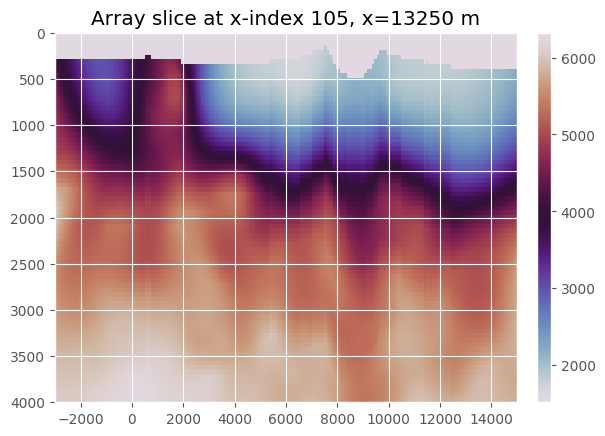

In [37]:
key = 'spike_fwhm1400_ampl005'
p = en.inv[key]
p.reinit('./')
p.i.svp.plot(coord=13250, axis='x', unit='m')

####  'spike_fwhm0800_ampl050'

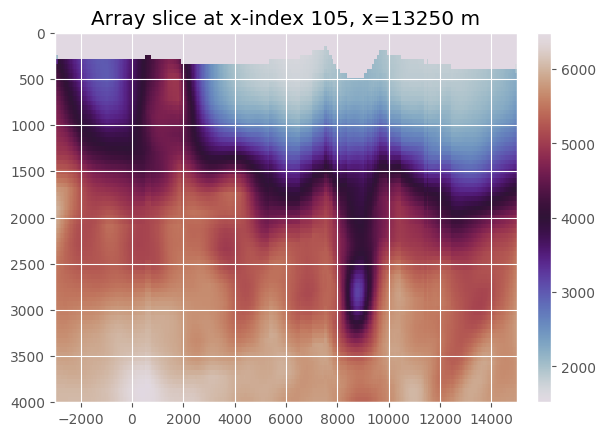

In [49]:
key = 'spike_fwhm0800_ampl050'
p = en.inv[key]
p.reinit('./')
p.o.vp.it[140].plot(coord=13250, axis='x', unit='m')

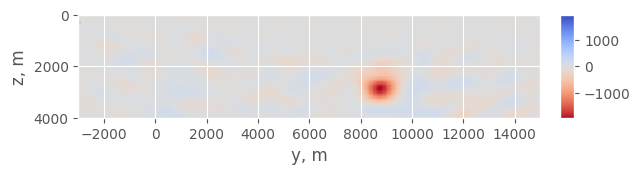

In [58]:
a = p.o.vp.it[140].read()
b = p.i.svp.read()
dif = Arr3d(a-b, extent=a.extent)
dif.plot(13250, unit='m', cmap='coolwarm_r', center_cmap=1)

(0, 100)

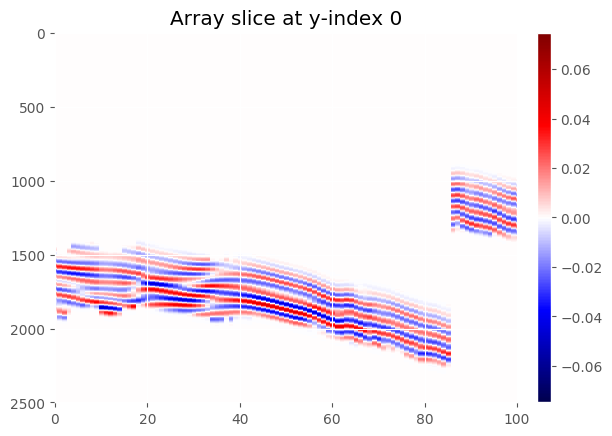

In [53]:
p.o.dc.it[140][4139].plot()
plt.xlim(0,100)

####  'spike_fwhm0

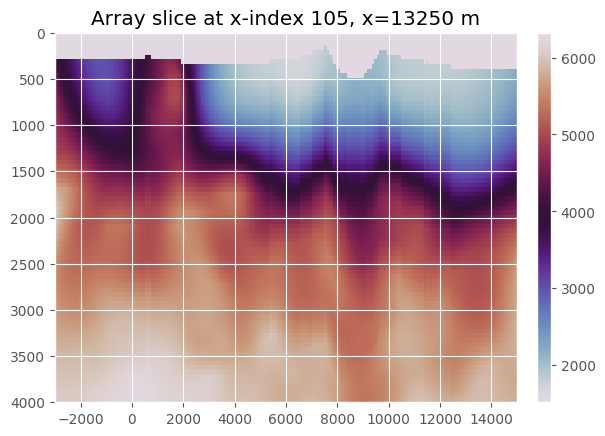

In [37]:
key = 'spike_fwhm1400_ampl005'
p = en.inv[key]
p.reinit('./')
p.i.svp.plot(coord=13250, axis='x', unit='m')

In [41]:
a = p.o.vp.it[110].read()
b = p.i.svp.read()

In [ ]:
dif = Arr3d(a-b, extent=a.extent)

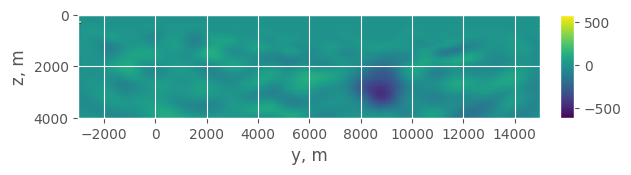

In [47]:
dif.plot(13250, unit='m')

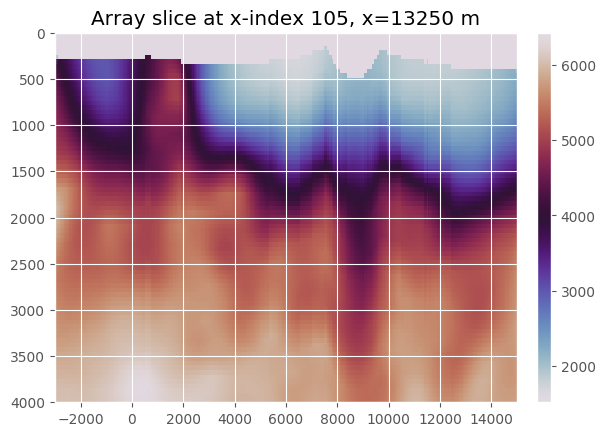

In [39]:
key = 'spike_fwhm1400_ampl010'
p = en.inv[key]
p.reinit('./')
p.o.vp.it[110].plot(coord=13250, axis='x', unit='m')

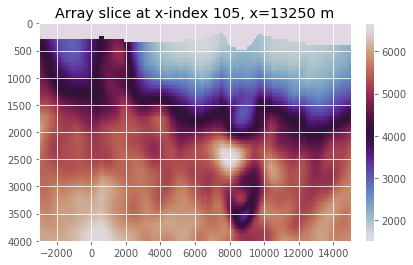

In [22]:
key = 'spike_fwhm1400_ampl050'
p = en.inv[key]
p.reinit('./')
p.o.vp.it[160].plot(coord=13250, axis='x', unit='m')

In [7]:
key = 'spike_fwhm1400_ampl050'
p = en.inv[key]
p.reinit(path_eph)
for it in range(1, 161):
    print('it', it)
    break
#     !cp {p.o.vp.it[it].fname} {key}inv-CP00002-Vp.sgy

KeyboardInterrupt: 

# Previous take

## Inp

### Prerequisites

In [183]:
for fwhm in np.arange(200, 2100, 600):
    kw_chqr['fwhm'] = fwhm
    for ampl in list(np.arange(-0.5, -0.05, 0.4)) + list(np.arange(-0.05, -0.002, 0.04)):
        kw_chqr['ampl'] = ampl
        flow = 'sph_fwhm%s_ampl%s' % (str(fwhm).rjust(4,'0'), str(int((round(ampl,2)) * (-100))).rjust(3,'0'))
        f = FlowInvObsChq(flow, './')
        f.run([0], **dict(geom_kol, ns=3000), exp='proteus', precode='sp-316', fwicode='fw3d-690', ibmcode=None)
#         lll(10)
#         f.syn.i.ls()
        f.syn.i.rsync('my_eph')
        f = FlowInvObsChq(flow, path_eph)
        f.run([0], **dict(geom_kol, ns=3000), exp='proteus', precode='sp-316', fwicode='fw3d-690', ibmcode=None)
        f.syn.i.ls()
        lll(40)

Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Content of /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch_unc/sph_fwhm0200_ampl050syn/inp

total 783M
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:28 sph_fwhm0200_ampl050syn-Run1.pbs
-rwx------ 1 kmc3817 root    0 Jul  6 13:28 fullwave3d-verbose-slave-1
-rwx------ 1 kmc3817 root    0 Jul  6 13:28 fullwave3d-verbose-scheduler
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:28 sph_fwhm0200_ampl050syn-Run0.pbs
-rwx------ 1 kmc3817 root 3.0K Jul  6 13:28 sph_fwhm0200_ampl050syn-Runfile.key
-rwx------ 1 kmc3817 root 2.1K Jul  6 13:28 sph_fwhm0200_ampl050syn-SegyPrep.log
-rwx------ 1 kmc3817 root  52K Jul  6 13:28 sph_fwhm0200_ampl050syn-Retained-Receivers.ps
-rwx------ 1 kmc3817 root 8.2K Jul  6 13:28 sph_fwhm0200_ampl050syn-Retained-Sources.ps
-rwx------ 1 kmc3817 root 1.7K Jul  6 13:28 sph_fwhm0200_ampl050syn-Skeleton.key
-rwx------ 1 kmc3817 root  998 Jul  6 13:28 sph_fwhm0200_ampl050s

Step 000: Initialising synthetic and inversion projects.
Content of /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch_unc/sph_fwhm0200_ampl001syn/inp

total 744M
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:34 sph_fwhm0200_ampl001syn-Run1.pbs
-rwx------ 1 kmc3817 root    0 Jul  6 13:34 fullwave3d-verbose-slave-1
-rwx------ 1 kmc3817 root    0 Jul  6 13:34 fullwave3d-verbose-scheduler
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:34 sph_fwhm0200_ampl001syn-Run0.pbs
-rwx------ 1 kmc3817 root 3.0K Jul  6 13:34 sph_fwhm0200_ampl001syn-Runfile.key
-rwx------ 1 kmc3817 root 2.1K Jul  6 13:34 sph_fwhm0200_ampl001syn-SegyPrep.log
-rwx------ 1 kmc3817 root  52K Jul  6 13:34 sph_fwhm0200_ampl001syn-Retained-Receivers.ps
-rwx------ 1 kmc3817 root 8.2K Jul  6 13:34 sph_fwhm0200_ampl001syn-Retained-Sources.ps
-rwx------ 1 kmc3817 root 1.7K Jul  6 13:34 sph_fwhm0200_ampl001syn-Skeleton.key
-rwx------ 1 kmc3817 root  998 Jul  6 13:34 sph_fwhm0200_ampl001syn-SourceSig-Time.log
-rwx------ 1 kmc3817 root 1.2K Jul 

Step 000: Initialising synthetic and inversion projects.
Content of /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch_unc/sph_fwhm0800_ampl005syn/inp

total 783M
-rwx------ 1 kmc3817 root  39M Jul  6 14:06 sph_fwhm0800_ampl005syn-BckgVp.mmp
-rwx------ 1 kmc3817 root  39M Jul  6 14:06 sph_fwhm0800_ampl005syn-BckgVp.vtr
-rwx------ 1 kmc3817 root  39M Jul  6 14:06 sph_fwhm0800_ampl005syn-TrueVp.mmp
-rwx------ 1 kmc3817 root  39M Jul  6 14:06 sph_fwhm0800_ampl005syn-TrueVp.vtr
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:40 sph_fwhm0800_ampl005syn-Run1.pbs
-rwx------ 1 kmc3817 root    0 Jul  6 13:40 fullwave3d-verbose-slave-1
-rwx------ 1 kmc3817 root    0 Jul  6 13:40 fullwave3d-verbose-scheduler
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:40 sph_fwhm0800_ampl005syn-Run0.pbs
-rwx------ 1 kmc3817 root 3.0K Jul  6 13:40 sph_fwhm0800_ampl005syn-Runfile.key
-rwx------ 1 kmc3817 root 2.1K Jul  6 13:40 sph_fwhm0800_ampl005syn-SegyPrep.log
-rwx------ 1 kmc3817 root  52K Jul  6 13:40 sph_fwhm0800_ampl005s

Step 000: Initialising synthetic and inversion projects.
Content of /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch_unc/sph_fwhm1400_ampl010syn/inp

total 744M
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:46 sph_fwhm1400_ampl010syn-Run1.pbs
-rwx------ 1 kmc3817 root    0 Jul  6 13:46 fullwave3d-verbose-slave-1
-rwx------ 1 kmc3817 root    0 Jul  6 13:46 fullwave3d-verbose-scheduler
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:46 sph_fwhm1400_ampl010syn-Run0.pbs
-rwx------ 1 kmc3817 root 3.0K Jul  6 13:46 sph_fwhm1400_ampl010syn-Runfile.key
-rwx------ 1 kmc3817 root 2.1K Jul  6 13:46 sph_fwhm1400_ampl010syn-SegyPrep.log
-rwx------ 1 kmc3817 root  52K Jul  6 13:46 sph_fwhm1400_ampl010syn-Retained-Receivers.ps
-rwx------ 1 kmc3817 root 8.2K Jul  6 13:46 sph_fwhm1400_ampl010syn-Retained-Sources.ps
-rwx------ 1 kmc3817 root 1.7K Jul  6 13:46 sph_fwhm1400_ampl010syn-Skeleton.key
-rwx------ 1 kmc3817 root  998 Jul  6 13:46 sph_fwhm1400_ampl010syn-SourceSig-Time.log
-rwx------ 1 kmc3817 root 1.2K Jul 

Step 000: Initialising synthetic and inversion projects.
Content of /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch_unc/sph_fwhm2000_ampl050syn/inp

total 744M
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:52 sph_fwhm2000_ampl050syn-Run1.pbs
-rwx------ 1 kmc3817 root    0 Jul  6 13:52 fullwave3d-verbose-slave-1
-rwx------ 1 kmc3817 root    0 Jul  6 13:52 fullwave3d-verbose-scheduler
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:52 sph_fwhm2000_ampl050syn-Run0.pbs
-rwx------ 1 kmc3817 root 3.0K Jul  6 13:52 sph_fwhm2000_ampl050syn-Runfile.key
-rwx------ 1 kmc3817 root 2.1K Jul  6 13:52 sph_fwhm2000_ampl050syn-SegyPrep.log
-rwx------ 1 kmc3817 root  52K Jul  6 13:52 sph_fwhm2000_ampl050syn-Retained-Receivers.ps
-rwx------ 1 kmc3817 root 8.2K Jul  6 13:52 sph_fwhm2000_ampl050syn-Retained-Sources.ps
-rwx------ 1 kmc3817 root 1.7K Jul  6 13:52 sph_fwhm2000_ampl050syn-Skeleton.key
-rwx------ 1 kmc3817 root  998 Jul  6 13:52 sph_fwhm2000_ampl050syn-SourceSig-Time.log
-rwx------ 1 kmc3817 root 1.2K Jul 

Step 000: Initialising synthetic and inversion projects.
Content of /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch_unc/sph_fwhm2000_ampl001syn/inp

total 783M
-rwx------ 1 kmc3817 root  39M Jul  6 14:04 sph_fwhm2000_ampl001syn-TrueVp.mmp
-rwx------ 1 kmc3817 root  39M Jul  6 14:04 sph_fwhm2000_ampl001syn-TrueVp.vtr
-rwx------ 1 kmc3817 root  39M Jul  6 14:04 sph_fwhm2000_ampl001syn-BckgVp.mmp
-rwx------ 1 kmc3817 root  39M Jul  6 14:04 sph_fwhm2000_ampl001syn-BckgVp.vtr
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:58 sph_fwhm2000_ampl001syn-Run1.pbs
-rwx------ 1 kmc3817 root    0 Jul  6 13:58 fullwave3d-verbose-slave-1
-rwx------ 1 kmc3817 root    0 Jul  6 13:58 fullwave3d-verbose-scheduler
-rwx------ 1 kmc3817 root 2.5K Jul  6 13:58 sph_fwhm2000_ampl001syn-Run0.pbs
-rwx------ 1 kmc3817 root 3.0K Jul  6 13:58 sph_fwhm2000_ampl001syn-Runfile.key
-rwx------ 1 kmc3817 root 2.1K Jul  6 13:58 sph_fwhm2000_ampl001syn-SegyPrep.log
-rwx------ 1 kmc3817 root  52K Jul  6 13:58 sph_fwhm2000_ampl001s

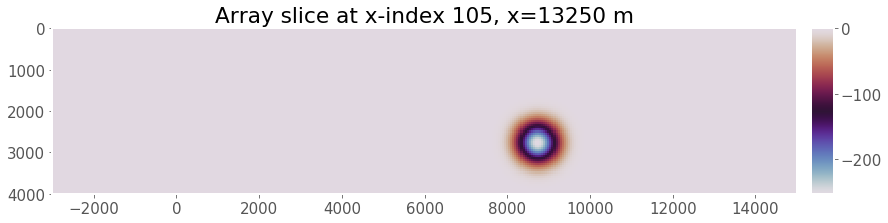

In [139]:
figure(14,4)
A3d(f.syn.i.tvp.read(overwrite_mmp=1)-f.syn.i.tvp.bckg.read(), extent=b.extent).plot(x0, axis='x', unit='m', cmap='twilight', aspect='equal')

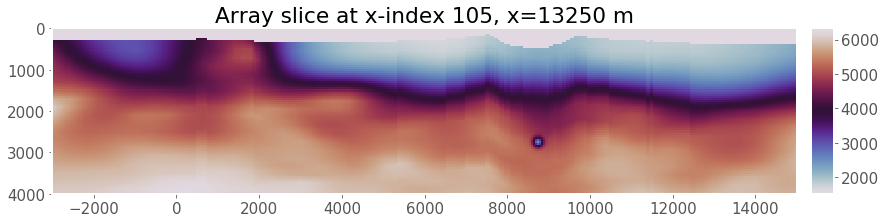

In [123]:
figure(14,4)
A3d(f.syn.i.tvp.read(overwrite_mmp=1)).plot(x0, axis='x', unit='m', cmap='twilight', aspect='equal')

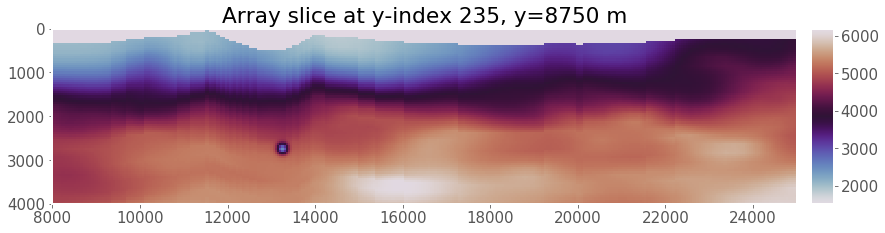

In [124]:
figure(14,4)
A3d(f.syn.i.tvp.read()).plot(y0, axis='y', unit='m', cmap='twilight', aspect='equal')

### Inversion

#### Alg.
Inverting the data.

In [24]:
%%time 
lll(40)
for fwhm in np.arange(200, 2100, 600):
    for ampl in list(np.arange(-0.5, -0.05, 0.4)) + list(np.arange(-0.05, -0.002, 0.04)):
        flow = 'sph_fwhm%s_ampl%s' % (str(fwhm).rjust(4,'0'), str(int((round(ampl,2)) * (-100))).rjust(3,'0'))
        f = FlowInvObsChq(flow, path_eph)
        f.run([0], **dict(geom_kol, ns=2000), exp='proteus', precode='sp-316', fwicode='fw3d-690', ibmcode=None)
        self = f.inv   
#         syn_proj = f.syn
#         self.i.rsg.dupl(syn_proj.i.rsg.fname)
#         self.i.svp.dupl(syn_proj.i.tvp.bckg.fname)
#         obs_file = syn_proj.o.syn.fname
#         self.i.obs.dupl(obs_file)
#         self.i.obs.raw.dupl(obs_file) # NOTE
#         self.i.rse.prep(fnames=[self.i.obs.raw.name])
#         self.i.sp.prep(**dict(syn_proj.i.sp.read(), problem=self.problem), cat=0)
#         self.i.sp.run(cat=1)
#         self.i.rnf.prep(b_abs=5, e_abs=10)
#         self.i.pbs.no[1].prep(hours=10, select=9, mpiprocs=2)
        self.i.pbs.no[2].prep(hours=20, select=9, mpiprocs=2)

Step 000: Initialising synthetic and inversion projects.
Content of  /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch_unc//sph_fwhm0200_ampl050inv//inp/sph_fwhm0200_ampl050inv-Run2.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N sph_fwhm0200_ampl050inv
#PBS -o ../out/sph_fwhm0200_ampl050inv-JobOut2.log
#PBS -e ../out/sph_fwhm0200_ampl050inv-JobErr2.log
#PBS -l walltime=20:00:00
#PBS -l select=9:mpiprocs=2:ompthreads=20:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/sph_fwhm0200_ampl050inv-Runfile.key   
    rm $work_dir/sph_fwhm0200_ampl050inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/

Content of  /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch_unc//sph_fwhm0800_ampl050inv//inp/sph_fwhm0800_ampl050inv-Run2.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N sph_fwhm0800_ampl050inv
#PBS -o ../out/sph_fwhm0800_ampl050inv-JobOut2.log
#PBS -e ../out/sph_fwhm0800_ampl050inv-JobErr2.log
#PBS -l walltime=20:00:00
#PBS -l select=9:mpiprocs=2:ompthreads=20:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/sph_fwhm0800_ampl050inv-Runfile.key   
    rm $work_dir/sph_fwhm0800_ampl050inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT

Content of  /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch_unc//sph_fwhm1400_ampl050inv//inp/sph_fwhm1400_ampl050inv-Run2.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N sph_fwhm1400_ampl050inv
#PBS -o ../out/sph_fwhm1400_ampl050inv-JobOut2.log
#PBS -e ../out/sph_fwhm1400_ampl050inv-JobErr2.log
#PBS -l walltime=20:00:00
#PBS -l select=9:mpiprocs=2:ompthreads=20:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/sph_fwhm1400_ampl050inv-Runfile.key   
    rm $work_dir/sph_fwhm1400_ampl050inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT

Content of  /home/kmc3817/rds_home/my_ephemeral/PROJECTS/ch_unc//sph_fwhm2000_ampl050inv//inp/sph_fwhm2000_ampl050inv-Run2.pbs : 
#!/bin/bash

##
# FULLWAVE3D WILL BE RUN FROM proj/out/
# For more explanation, see help(fullwavepy.project.files.runfiles.PbsFile).
#
##

#PBS -N sph_fwhm2000_ampl050inv
#PBS -o ../out/sph_fwhm2000_ampl050inv-JobOut2.log
#PBS -e ../out/sph_fwhm2000_ampl050inv-JobErr2.log
#PBS -l walltime=20:00:00
#PBS -l select=9:mpiprocs=2:ompthreads=20:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

start=`date +%s`

    # PATHS
    code_path=~/PhD/fullwave3D/rev690/bin/fullwave3D.exe
    echo 'code_path: '${code_path}

    work_dir=$PBS_O_WORKDIR/../out/ # $PBS_O_WORKDIR IS THE ONE CONTAINING THIS SCRIPT
    
    # CAVEAT  
    rm $work_dir/sph_fwhm2000_ampl050inv-Runfile.key   
    rm $work_dir/sph_fwhm2000_ampl050inv-Ghost.*


    # HARD-LINK INPUT FILES TO OUTPUT DIR WHERE THE CODE WILL RUN
    ln $PBS_O_WORKDIR/* $work_dir
    
    # CHANGE DIRECTORY TO PROJECT OUTPUT

## Out

#### Alg.
Plotting and saving output - recovery.

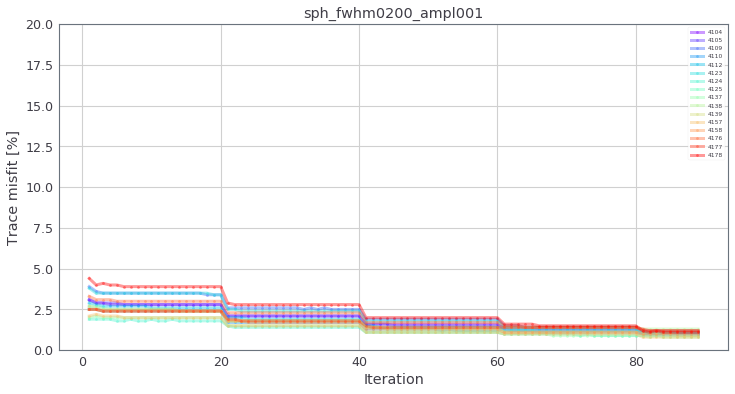

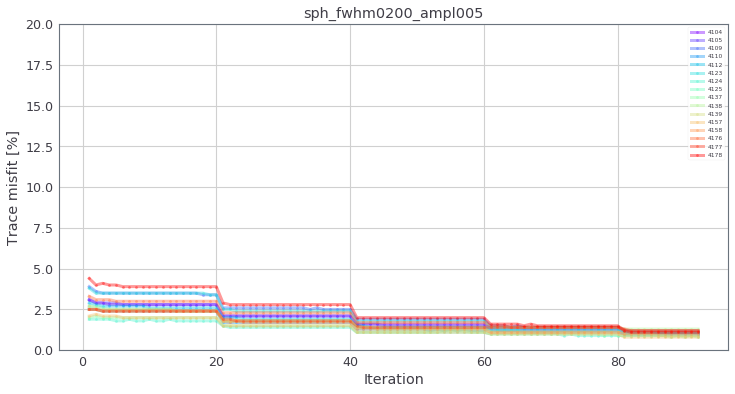

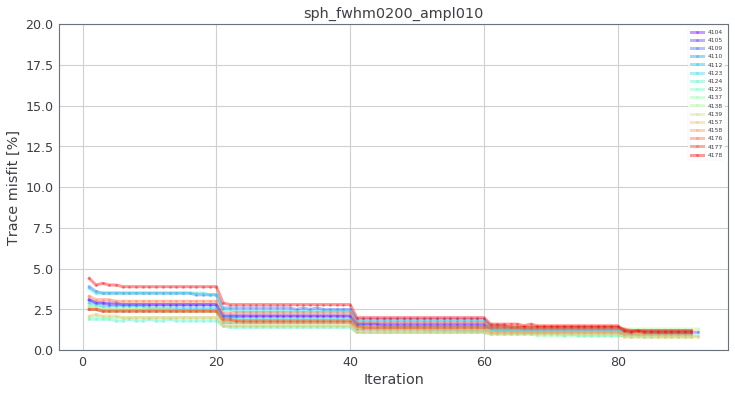

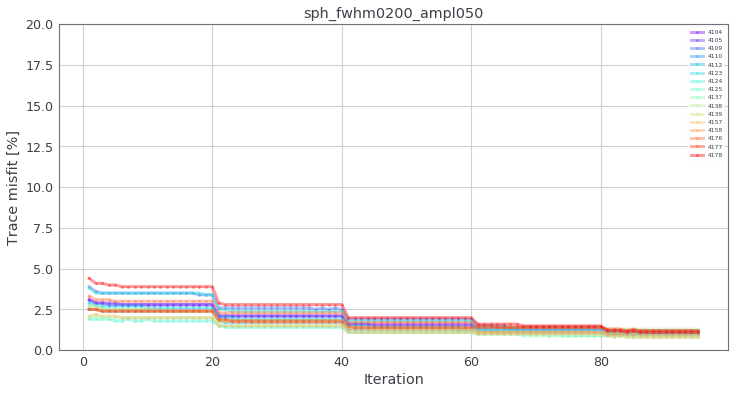

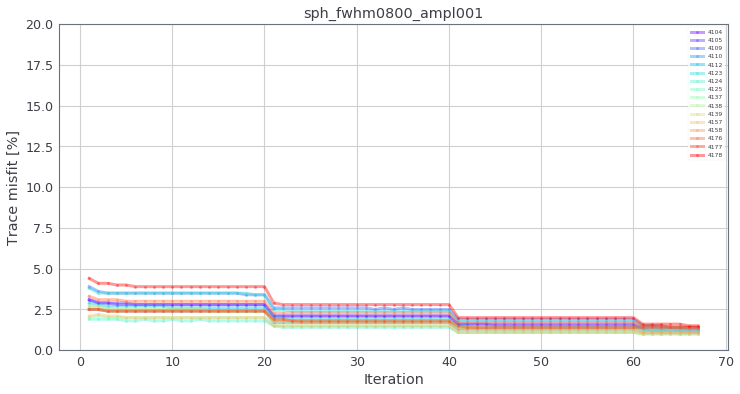

...

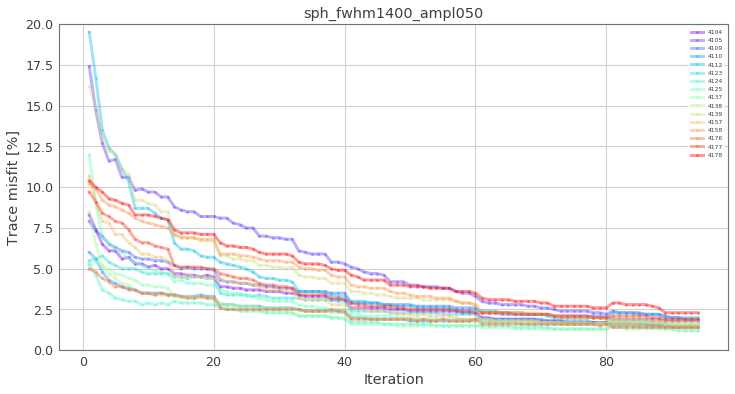

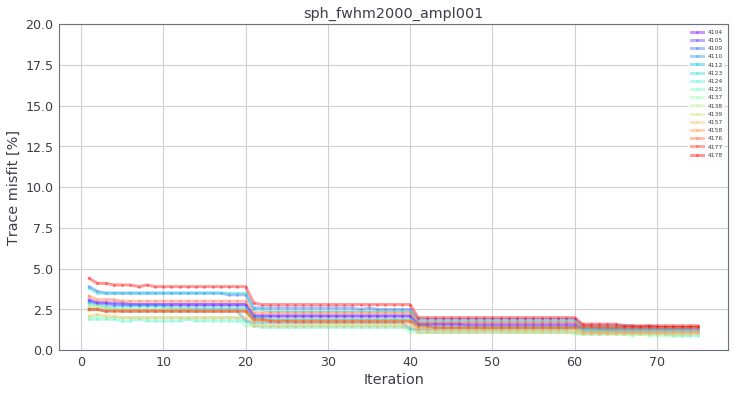

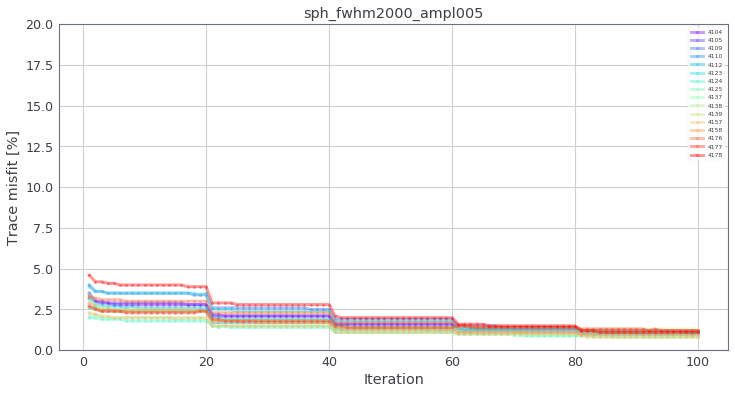

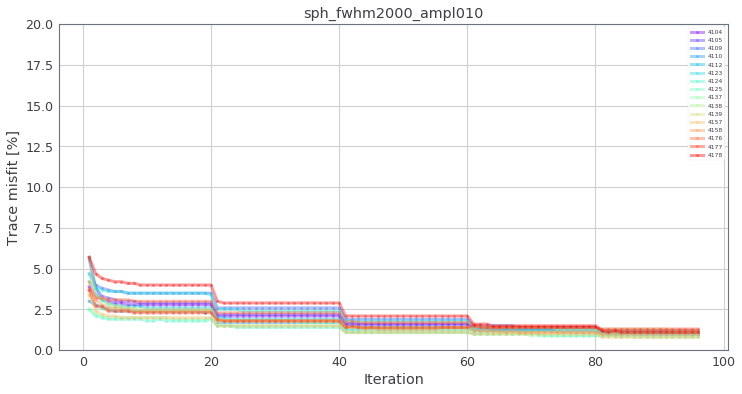

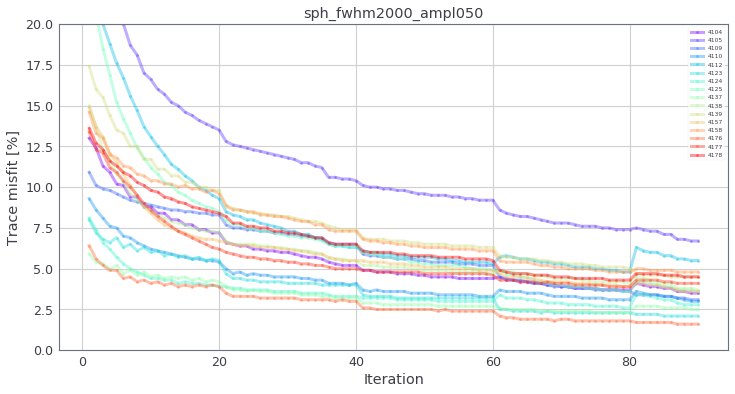

In [12]:
for key, f in sorted(e.flow.items()):
    figure(12,6)
    plt.title(key)
    f.inv.o.fit.plot(run_ids=[1])
    plt.ylim(0,20)
    plt.savefig('../../figures/ch_kol/unc_%s_fit.png' % key)
#     plt.close()

In [18]:
svp = f.inv.o.vp.it[0].read()
extent = np.array([[ 8000., 25000.],
       [-3000., 15000.],
       [    0.,  4000.]])
def plot_slice(coord, axis, flow, it, key, svp, extent):
    kwargs = dict(coord=coord, unit='m', axis=axis, cmap='coolwarm_r', center_cmap=1, aspect='equal', clip=50)
    figure(14,5)
#     plt.suptitle(key)
    plt.subplot(121)
    a = A3d(f.inv.o.vp.it[it].read() - svp, extent=extent)
    a.plot(**kwargs)
    plt.subplot(122)
    b = A3d(f.syn.i.tvp.read(overwrite_mmp=1) - svp, extent=extent)
    b.plot(**kwargs)
    plt.savefig('../../figures/ch_kol/unc_%s_vp_it%s_%sslice.png' % (key, it, axis))
def plot_3slices(coords, flow, it, key, svp, extent):
    plot_slice(coords[0], 'x', flow, it, key, svp, extent)
    plot_slice(coords[1], 'y', flow, it, key, svp, extent)
    plot_slice(coords[2], 'z', flow, it, key, svp, extent)

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


CPU times: user 17min 29s, sys: 6min 56s, total: 24min 25s
Wall time: 36min 5s


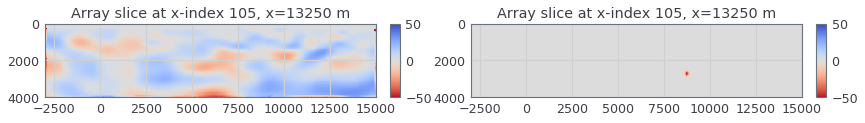

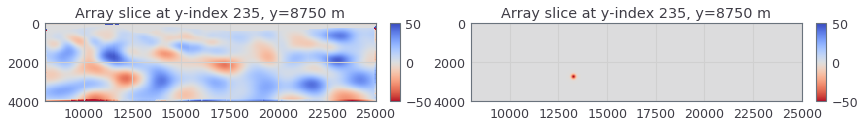

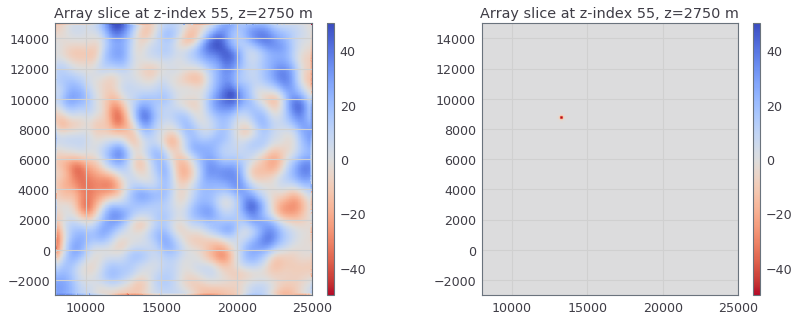

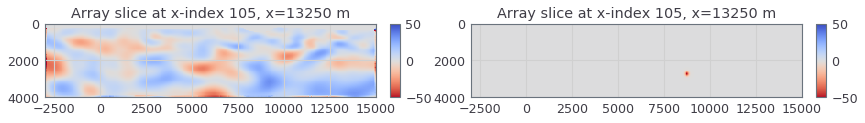

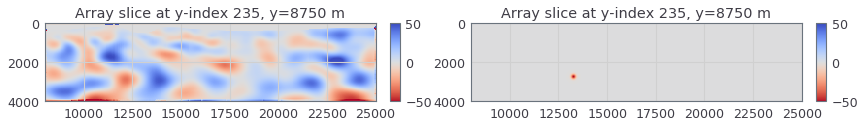

...

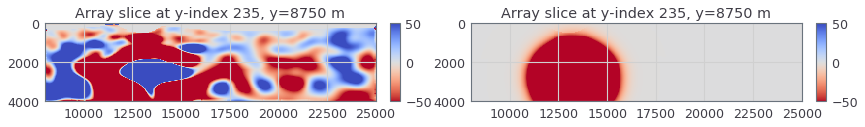

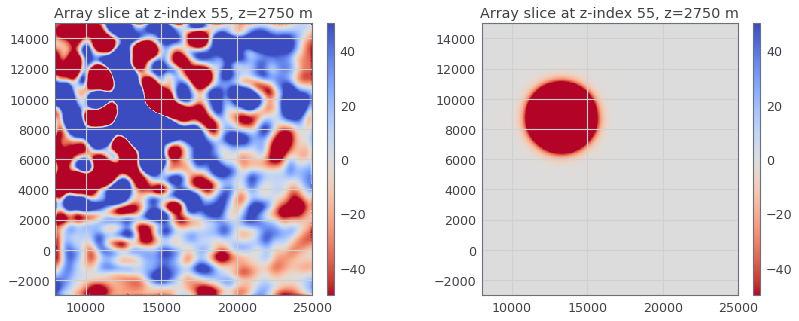

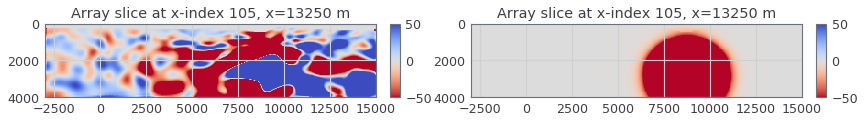

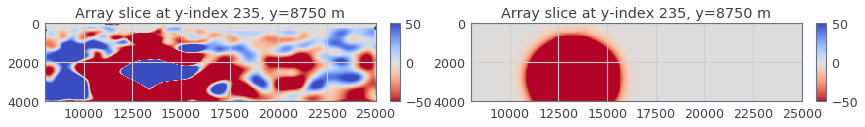

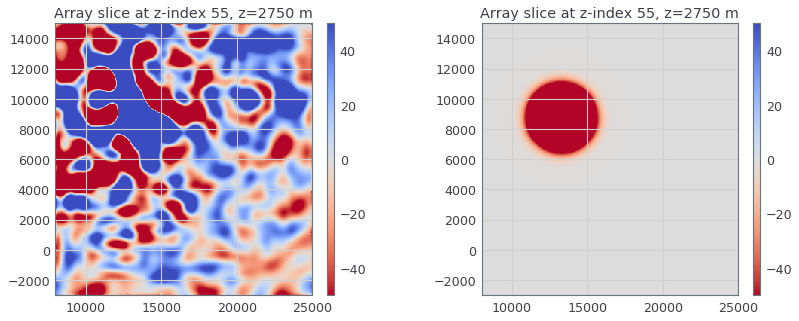

In [19]:
%%time 
# took 36 min
kwargs = dict(coord=z0, unit='m', axis='z', cmap='coolwarm_r', center_cmap=1, aspect='equal', clip=50)
for key, f in sorted(e.flow.items()):
    for it in np.arange(20,81,20):
        try:
            plot_3slices([x0,y0,z0], f, it, f.name, svp, extent)
        except FileNotFoundError:
            continue

#### Alg.
Plotting and saving data fit.

In [7]:
%%time 
lll(40)
for fwhm in np.arange(200, 2100, 600):
    for ampl in list(np.arange(-0.5, -0.05, 0.4)) + list(np.arange(-0.05, -0.002, 0.04)):
        flow = 'sph_fwhm%s_ampl%s' % (str(fwhm).rjust(4,'0'), str(int((round(ampl,2)) * (-100))).rjust(3,'0'))
        f = FlowInvObsChq(flow, path_eph)
        f.run([0], **dict(geom_kol, ns=2000), exp='proteus', precode='sp-316', fwicode='fw3d-690', ibmcode=None)
        self = f.inv 

Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
Step 000: Initialising synthetic and inversion projects.
CPU times: user 4.68 s, sys: 1.57 s, total: 6.25 s
Wall time: 1min 41s


(0, 6)

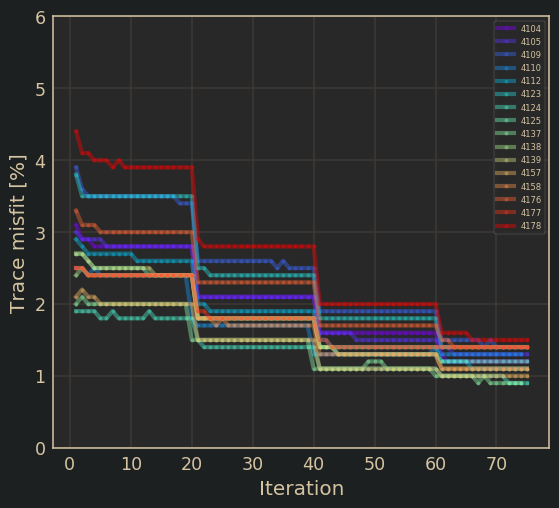

In [8]:
self.o.fit.plot(run_ids=[1])
plt.ylim(0,6)

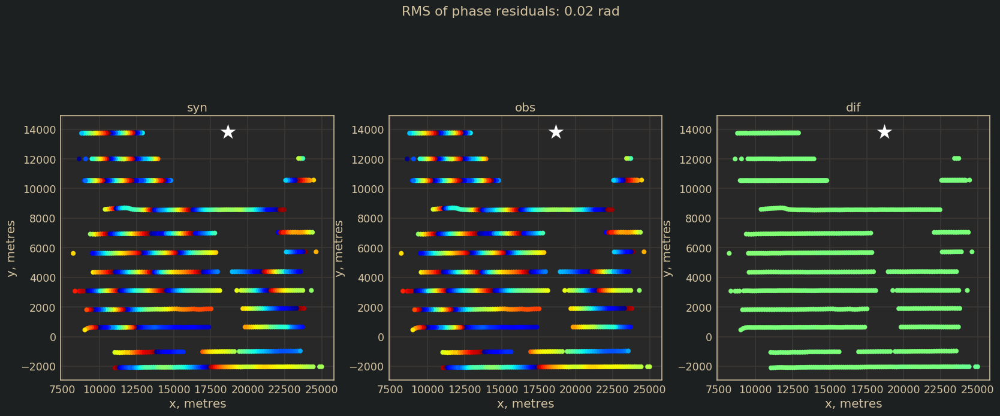

In [10]:
self.o.dc.it[1][4104].plot_phase(freq=3)

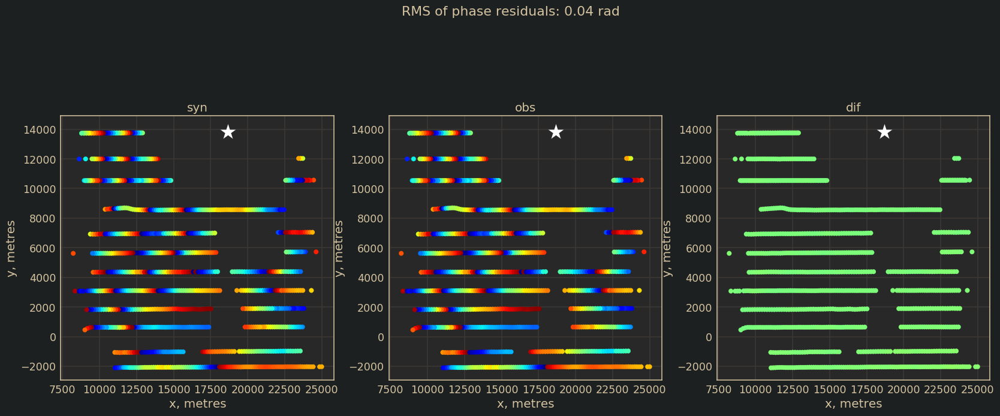

In [11]:
self.o.dc.it[70][4104].plot_phase(freq=3)

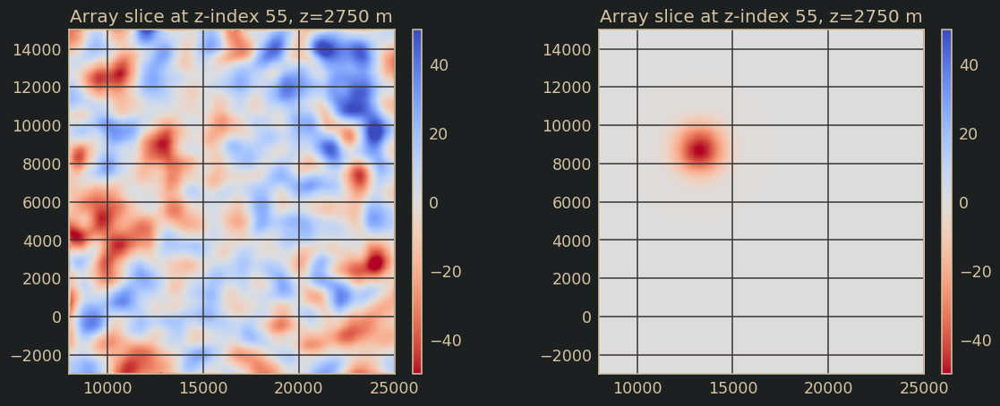

In [22]:
# plot 
kwargs = dict(coord=z0, unit='m', axis='z', cmap='coolwarm_r', center_cmap=1, aspect='equal', clip=50)
figure(14,5)
plt.subplot(121)
a = A3d(f.inv.o.vp.it[70].read() - f.inv.o.vp.it[0].read(), extent=f.inv.o.vp.it[2].read().extent)
a.plot(**kwargs)

plt.subplot(122)
b = A3d(f.syn.i.tvp.read() - f.inv.o.vp.it[0].read(), extent=f.inv.o.vp.it[2].extent)
b.plot(**kwargs)

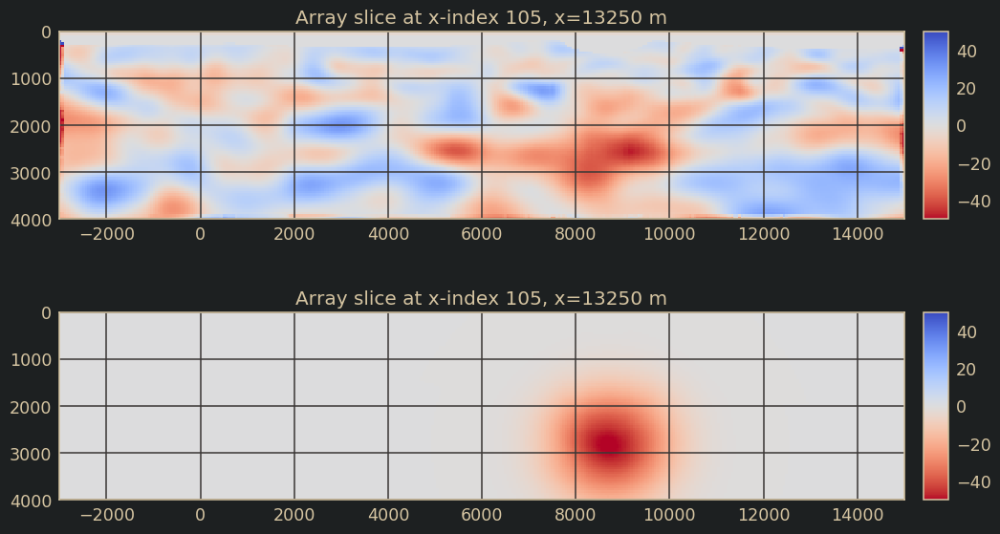

In [21]:
# plot 
kwargs = dict(coord=x0, axis='x', unit='m', cmap='coolwarm_r', center_cmap=1, aspect='equal', clip=50)
figure(12,7)
plt.subplot(211)
a = A3d(f.inv.o.vp.it[70].read() - f.inv.o.vp.it[0].read(), extent=f.inv.o.vp.it[2].read().extent)
a.plot(**kwargs)

plt.subplot(212)
b = A3d(f.syn.i.tvp.read() - f.inv.o.vp.it[0].read(), extent=f.inv.o.vp.it[2].extent)
b.plot(**kwargs)

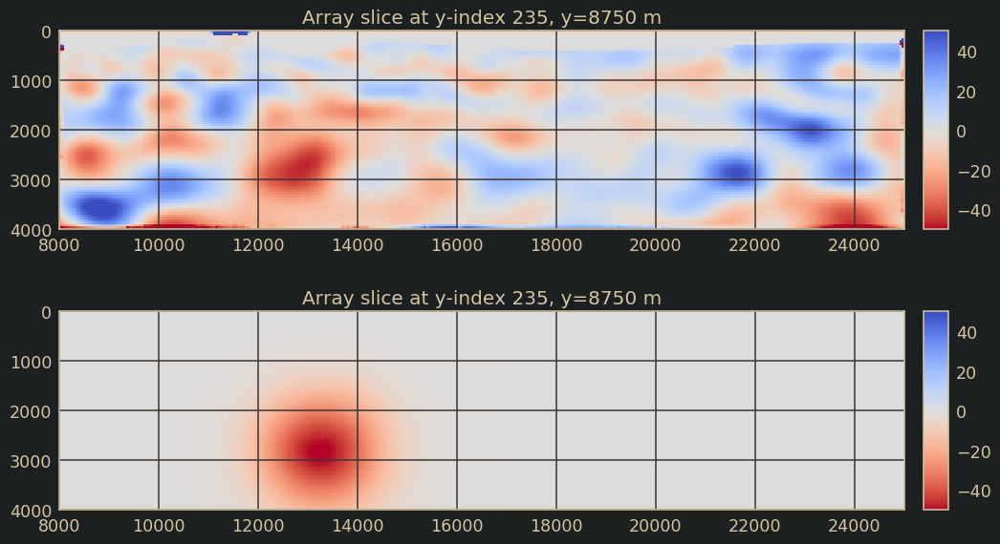

In [19]:
# plot 
kwargs = dict(coord=y0, unit='m', axis='y', cmap='coolwarm_r', center_cmap=1, aspect='equal', clip=50)
figure(12,7)
plt.subplot(211)
a = A3d(f.inv.o.vp.it[70].read() - f.inv.o.vp.it[0].read(), extent=f.inv.o.vp.it[2].read().extent)
a.plot(**kwargs)

plt.subplot(212)
b = A3d(f.syn.i.tvp.read() - f.inv.o.vp.it[0].read(), extent=f.inv.o.vp.it[2].extent)
b.plot(**kwargs)

# ...